# SIBUR competition baseline

Град. бустинг работает. Гипотезы по улучшению модели:
- временные признаки добавить как есть, без отбрасывания на этапе FE
- важность признаков проверять не на тестовых значениях, а на предсказываемых
- XGBoost
- модели для остальных задач !!!
- удалить тренд, сезонность

In [1]:
# Импорт нужных библиотек и настройка глобальных параметров ноутбука
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import hvplot.pandas
import holoviews as hv
import bokeh
import seaborn as sns

from sklearn.metrics import mean_squared_error as MSE
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import TimeSeriesSplit

%matplotlib inline
pd.set_option('display.max_columns', 500)
plt.rcParams['figure.figsize'] = (10,3)

targets = ['target', 'target2', 'target3', 'target4', 'target5']
time_features = ['c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 's1', 's2', 's3', 's4', 's5', 's6', 's7', 's8',
                'hour', 'day', 'weekday', 'month', 'is_weekend']

C:\Progs\Anaconda3\envs\Keras\lib\site-packages\sklearn\ensemble\weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d


In [2]:
# common functions
def print_learning_curve(history, skip_first=3):
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(len(loss))

    plt.plot(epochs[skip_first:], loss[skip_first:], 'bo', label='Training loss')
    plt.plot(epochs[skip_first:], val_loss[skip_first:], 'b', label='Validation loss')
    plt.title('Training and validation loss')
    plt.legend()

    plt.show()
    
def save_prediction(pred, index=None, filename='predict.csv'):
    # Save prediction to file, needed X_test for datetime index if index=None
    if index is None:
        df = pd.DataFrame(pred, index=X_test['2018':].index, columns=['target'])
    else:
        df = pd.DataFrame(pred, index=index, columns=['target'])
    df['target'].to_csv(filename, index=True, header=True)
    
def quality_metric(target, prediction, print_result=True):
    # Quality metric
    rmse_on_test = MSE(target, prediction)**0.5
    rmse_on_baseline = MSE([target.mean()] * len(target), prediction)**0.5
    
    if print_result:
        print('prediction rmse', rmse_on_test)
        print('simple mean() rmse', rmse_on_baseline)
    return rmse_on_test, rmse_on_baseline

def scale_dataframe(df, scaler):
    # scale df with scaler
    columns = df.columns
    index = df.index
    scaled_df = pd.DataFrame(scaler.transform(df), columns=columns, index=index)
    
    return scaled_df   

def restore_dataframe(scaled_df, scaler):
    columns = scaled_df.columns
    index = scaled_df.index
    df = pd.DataFrame(scaler.inverse_transform(scaled_df), columns=columns, index=index)
    return df


def train_test_split(df, train_len=None):
    if train_len is None:
        train_len = int(0.8*len(df))
    
    X_train = df.drop(targets[1:], axis=1).iloc[:train_len]
    y_train = df[targets].iloc[:train_len]
    X_test = df.drop(targets[1:], axis=1).iloc[train_len:]
    y_test = df[targets].iloc[train_len:]
    
    return X_train, y_train, X_test, y_test

In [3]:
def create_date_features(df, start_T=0):
    #df['minute'] = df.index.minute
    df['hour'] = df.index.hour
    df['day'] = df.index.day
    df['weekday'] = df.index.weekday
    df['month'] = df.index.month
    df['is_weekend'] = df.index.weekday.isin([5, 6]) * 1
    
    K = 8
    period = 7*24
    
    T = len(df) + 1
    # добавляем sin и cos признаки
    for k in range(1, K+1):
        df['s' + str(k)] = [np.sin(i * 2 * np.pi * k / period) for i in range(start_T + 1, start_T + T)]
        df['c' + str(k)] = [np.cos(i * 2 * np.pi * k / period) for i in range(start_T + 1, start_T + T)]
        
    return df


def generate_features(data, n_fast=8, n_slow=7*24):
    df = data.copy()
    df['fast_mean'] = df.target.rolling(n_fast).mean()
    df['slow_mean'] = df.target.rolling(n_slow).mean()

    df.fillna(method='bfill', inplace=True)

    return df


def preprocessing(df, train_data=True, generate_tearget_features=True):
    
    if train_data:
        df = create_date_features(df)
    else:
        df = create_date_features(df, start_T=len(X_train-1))
    if generate_tearget_features:
        df = generate_features(df)
    return df


def calc_corr_features(stats, corr_threshold = 0.40):
    high_corr = stats[stats.Trend_correlation>corr_threshold][['Feature', 'Trend_correlation']]
    low_corr = stats[stats.Trend_correlation<-corr_threshold][['Feature', 'Trend_correlation']]
    corr_features = pd.concat([high_corr, low_corr]) # + ['target']
    corr_features.set_index('Feature', inplace=True)
    corr_features = corr_features.sort_values('Trend_correlation')
    print('Total number of features: ', len(X_train_fe.columns))
    print('Number of highly correlated features: ', len(corr_features))
    corr_features.hvplot.barh(width=400, height=len(corr_features)*15)
    
    return corr_features

In [4]:
# count if feature not in mean +/- 3*std_dev
def anomaly_detection_std(df, feature_names=None, outliers_threshold = 10):
    std_mean = df.mean()
    std_dev = df.std()
    if feature_names is None:
        feature_names = df.columns
    
    X_outlier = pd.DataFrame(index=df.index)
    for col in feature_names:
        X_outlier[col+'_outlier'] = np.where(((df[col] > std_mean[col] + 3*std_dev[col]) 
                                            | (df[col] < std_mean[col] - 3*std_dev[col])), 1, 0)
    X_outlier['outliers_sum'] = X_outlier.sum(axis=1).astype('int')    
    df['outlier'] = np.where(X_outlier['outliers_sum'] > outliers_threshold, 1, 0)
    return df

def anomaly_markdown_std(df, std_mean, std_dev, feature_names=None, outliers_threshold = 10):
    X_outlier = pd.DataFrame(index=df.index)
    if feature_names is None:
        feature_names = df.columns
        
    for col in feature_names:
        X_outlier[col+'_outlier'] = np.where(((df[col] > std_mean[col] + 3*std_dev[col]) 
                                            | (df[col] < std_mean[col] - 3*std_dev[col])), 1, 0)
    X_outlier['outliers_sum'] = X_outlier.sum(axis=1).astype('int')    
    df['outlier'] = np.where(X_outlier['outliers_sum'] > outliers_threshold, 1, 0)
    return df

In [5]:
# read raw data
sensors = pd.read_csv('data/sensors.csv', parse_dates=['timestamp'], index_col='timestamp')
coke = pd.read_csv('data/coke_target.csv', parse_dates=['timestamp'], index_col='timestamp')
reactor_pressure = pd.read_csv('data/reactor_pressure_target.csv', parse_dates=['timestamp'], index_col='timestamp')

temp_on_he = pd.read_csv('data/temp_on_he_target.csv', parse_dates=['timestamp'], index_col='timestamp')
pressure_he = pd.read_csv('data/pressure_he_target.csv', parse_dates=['timestamp'], index_col='timestamp')
activity = pd.read_csv('data/activity_target.csv', parse_dates=['timestamp'], index_col='timestamp')

reactor_pressure.columns = ['target2']
temp_on_he.columns = ['target3']
pressure_he.columns = ['target4']
activity.columns = ['target5']

# merge to one dataframe
merged_df = pd.merge(sensors, coke, on='timestamp', how='outer')
merged_df = pd.merge(merged_df, reactor_pressure, on='timestamp', how='outer')
merged_df = pd.merge(merged_df, temp_on_he, on='timestamp', how='outer')
merged_df = pd.merge(merged_df, pressure_he, on='timestamp', how='outer')
merged_df = pd.merge(merged_df, activity, on='timestamp', how='outer')
merged_df = merged_df.fillna(method='ffill').fillna(method='bfill')

lookback = 30*24
step = 6
delay = 10
batch_size = 64

scaler = MinMaxScaler()
target_scaler = MinMaxScaler()
tscv = TimeSeriesSplit(n_splits=10)

validation_start_index = len(merged_df[:'2017-11-01 00:00:00'])
test_start_index = len(merged_df[:'2017-11-15 00:00:00'])
prediction_start_index = len(merged_df[:'2017-12-31 23:00:00'])

In [6]:
X_train, y_train, X_test, y_test = train_test_split(merged_df[:'2017-12-01 23:00:00'], len(merged_df[:'2017-11-01 23:00:00']))
X_train = scale_dataframe(X_train, scaler.fit(X_train))
y_train = scale_dataframe(y_train[['target']], target_scaler.fit(y_train[['target']]))
X_train = preprocessing(X_train)

X_test = scale_dataframe(X_test, scaler)
X_test = preprocessing(X_test, train_data=False)
feature_names = X_train.columns[:48].tolist()

In [7]:
width = 490
height = 200

train = merged_df[:'2017-12-31 23:00:00']
graph1 = train.f_0.hvplot(width = width, height = height) + train.target3.hvplot(width = width, height = height) + \
        train.target.hvplot(width = width, height = height) + train.target4.hvplot(width = width, height = height) + \
        train.target2.hvplot(width = width, height = height) + train.target5.hvplot(width = width, height = height)
graph1.cols(2)

:Layout
   .Curve.F_0     :Curve   [timestamp]   (f_0)
   .Curve.Target3 :Curve   [timestamp]   (target3)
   .Curve.Target  :Curve   [timestamp]   (target)
   .Curve.Target4 :Curve   [timestamp]   (target4)
   .Curve.Target2 :Curve   [timestamp]   (target2)
   .Curve.Target5 :Curve   [timestamp]   (target5)

### outliers detection on mean +/- 3*std_dev

In [91]:
feat = 'f_26'
X_train = anomaly_detection_std(X_train, feature_names=feature_names)
std_mean = X_train.mean()
std_dev = X_train.std()
print(std_mean[feat], std_dev[feat], '[', std_mean[feat] - 2*std_dev[feat], std_mean[feat] + 2*std_dev[feat], ']')
X_train[[feat, 'outlier']].hvplot()

0.9139219606478896 0.18292240781505398 [ 0.5480771450177816 1.2797667762779974 ]


:NdOverlay   [Variable]
   :Curve   [timestamp]   (value)

In [92]:
# basic boosting decision.. poor results witout time-specific features
tscv = TimeSeriesSplit(n_splits=10)
gbr = GradientBoostingRegressor()

y_train = X_train['target']
X_train = X_train.drop('target', axis=1)

scores=[]
full_prediction = []
for train_ind, test_ind in tscv.split(X_train):
    used_indexes = len(train_ind) + len(test_ind)
    gbr.fit(X_train.iloc[train_ind], y_train.iloc[train_ind])
    pred = gbr.predict(X_train.iloc[test_ind])
    
    # for drawing prediction
    full_prediction.append(np.concatenate([y_train[train_ind].values, pred, np.zeros(len(X_train) - used_indexes)]))
    
    score = MSE(y_train.iloc[test_ind], pred)**0.5
    scores.append(score)
    print('train len: ', len(train_ind), '\t till ', X_train.index[train_ind[-1]]  ,'\t score: ' , score)

print('average score: ', np.mean(scores))

train len:  820 	 till  2016-11-27 19:00:00 	 score:  0.029813911130446714
train len:  1634 	 till  2016-12-31 17:00:00 	 score:  0.017333509176076407
train len:  2448 	 till  2017-02-03 15:00:00 	 score:  0.05214006716650375
train len:  3262 	 till  2017-03-09 13:00:00 	 score:  0.021764822448875242
train len:  4076 	 till  2017-04-12 11:00:00 	 score:  0.041632304473685
train len:  4890 	 till  2017-05-16 09:00:00 	 score:  0.012756738324253215
train len:  5704 	 till  2017-06-19 07:00:00 	 score:  0.01304407999798071
train len:  6518 	 till  2017-07-23 05:00:00 	 score:  0.010693852875548525
train len:  7332 	 till  2017-08-26 03:00:00 	 score:  0.05940173728013599
train len:  8146 	 till  2017-09-29 01:00:00 	 score:  0.010299204354448763
average score:  0.02688802272279543


In [13]:
indices = np.argsort(gbr.feature_importances_)[::-1]
#X_train.columns.values[indices[:20]]
importance_df = pd.DataFrame({'importance': gbr.feature_importances_[indices[:20]]}, 
                             index=X_train.columns.values[indices[:20]])
importance_df.hvplot.barh()

:Bars   [index]   (importance)

In [94]:
# training step
pred_df = pd.DataFrame(full_prediction[7], index=X_train_fe.index)
print(pred_df.mean())
pred_df = restore_dataframe(pred_df, target_scaler)

quality_metric(merged_df.loc[pred_df.index].target, pred_df)
pred_df.hvplot() * merged_df.target.hvplot() * X_train_fe.outlier.hvplot()

0    0.305289
dtype: float64
prediction rmse 1.1865335178422716
simple mean() rmse 1.1441502322333443


:Overlay
   .Curve.I       :Curve   [timestamp]   (0)
   .Curve.Target  :Curve   [timestamp]   (target)
   .Curve.Outlier :Curve   [timestamp]   (outlier)

In [14]:
# validation step!
X_val_raw = merged_df['2017-12-01 23:00:00':'2018-01-01 00:00:00'].drop(targets[1:], axis=1)
y_val = merged_df['2017-12-01 23:00:00':'2018-01-01 00:00:00'][['target']]

X_val = scale_dataframe(X_val_raw, scaler)
X_val = preprocessing(X_val, train_data=False)
X_val = anomaly_markdown_std(X_val, X_train.mean(), X_train.std(), feature_names=feature_names, outliers_threshold=10)

val_pred = gbr.predict(X_val.drop('target', axis=1))

pred_df = pd.DataFrame(val_pred, index=X_val_raw.index, columns=['prediction'])
pred_df = restore_dataframe(pred_df, target_scaler)
quality_metric(y_val, pred_df.prediction)

prediction rmse 0.07189278182475312
simple mean() rmse 0.23403661082812385


(0.07189278182475312, 0.23403661082812385)

In [15]:
pred_df.prediction.hvplot() * y_val.target.hvplot()

:Overlay
   .Curve.Prediction :Curve   [timestamp]   (prediction)
   .Curve.Target     :Curve   [timestamp]   (target)

In [16]:
# draw prediction - score is 0.07381683384538541
# best is scale all features and boosting

pred_df = pd.DataFrame(full_prediction[9], index=X_train.index)
pred_df = restore_dataframe(pred_df, target_scaler)
print(pred_df.mean())

quality_metric(pred_df, merged_df.loc[pred_df.index].target)
pred_df.hvplot() * merged_df.target.hvplot()

0    3.140359
dtype: float64
prediction rmse 0.02000395865115537
simple mean() rmse 0.5346552116093015


:Overlay
   .Curve.I      :Curve   [timestamp]   (0)
   .Curve.Target :Curve   [timestamp]   (target)

In [17]:
# prediction
X_pred = merged_df['2018-01-01 00:00:00':].drop(targets[1:], axis=1)
X_pred = scale_dataframe(X_pred, scaler)
X_pred = preprocessing(X_pred, train_data=False)
X_pred = anomaly_markdown_std(X_pred, X_train.mean(), X_train.std(), feature_names=feature_names, outliers_threshold=10)

pred = gbr.predict(X_pred.drop('target', axis=1))

pred_df = pd.DataFrame(pred, index=X_pred.index, columns=['prediction'])
pred_df = restore_dataframe(pred_df, target_scaler)

#save_prediction(pred_df.values, index=pred_df.index, filename='grad_boost_anomaly.csv')

pred_df.prediction.hvplot() * merged_df.target.hvplot()*X_pred.outlier.hvplot()

# scaled sklearn boosting
# 0.4770 оценка  RMSE
#  my score: 0.026882 -> 0.07301195

:Overlay
   .Curve.Prediction :Curve   [timestamp]   (prediction)
   .Curve.Target     :Curve   [timestamp]   (target)
   .Curve.Outlier    :Curve   [timestamp]   (outlier)

# feature importance!

In [7]:
from featexp import get_univariate_plots
from featexp import get_trend_stats

X_train_fe, y_train_fe, X_test_fe, y_test_fe = train_test_split(merged_df[:'2017-12-01 23:00:00'], 
                                                                len(merged_df[:'2017-11-01 23:00:00']))
X_train_fe = scale_dataframe(X_train_fe, scaler.fit(X_train_fe))
y_train_fe = scale_dataframe(y_train_fe[['target']], target_scaler.fit(y_train_fe[['target']]))
X_train_fe = preprocessing(X_train_fe)
X_train_fe = anomaly_detection_std(X_train_fe, feature_names=feature_names)

X_test_fe = scale_dataframe(X_test_fe, scaler)
X_test_fe = preprocessing(X_test_fe, train_data=False)

                                            Plots for f_0                                             
                                           Train data plots                                           


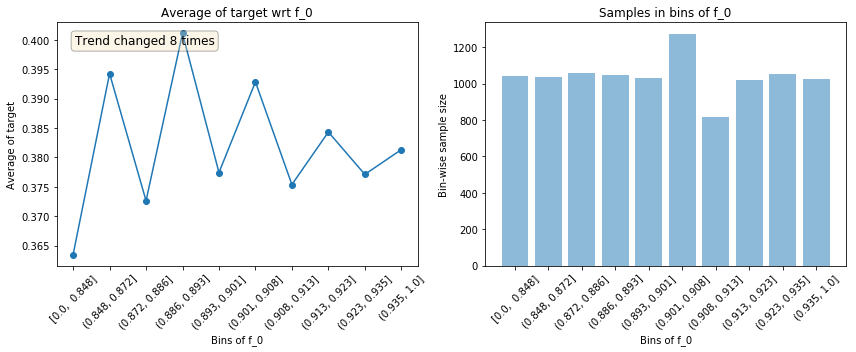

                                           Test data plots                                            


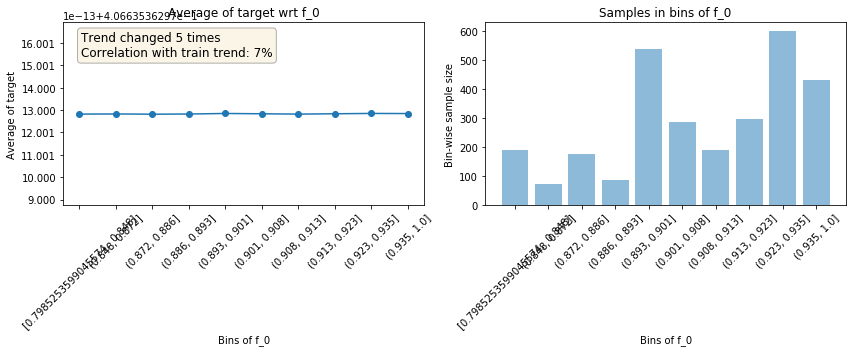

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_1                                             
                                           Train data plots                                           


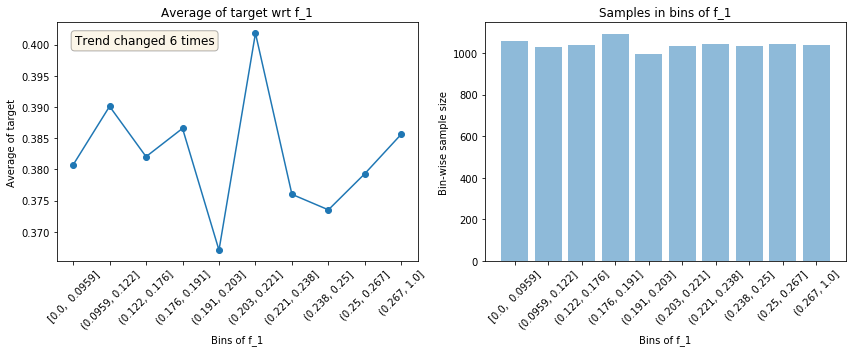

                                           Test data plots                                            


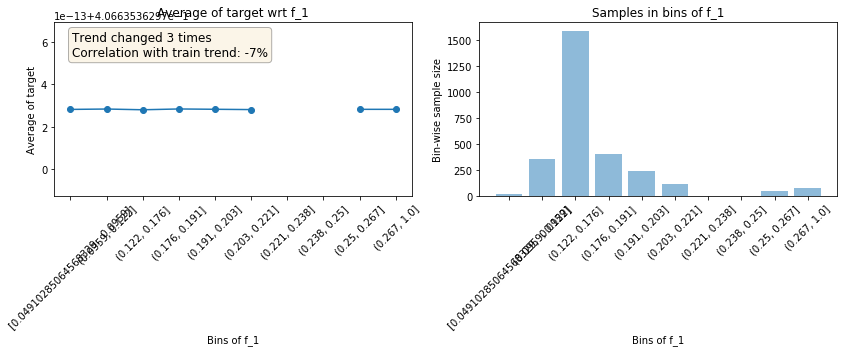

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_2                                             
                                           Train data plots                                           


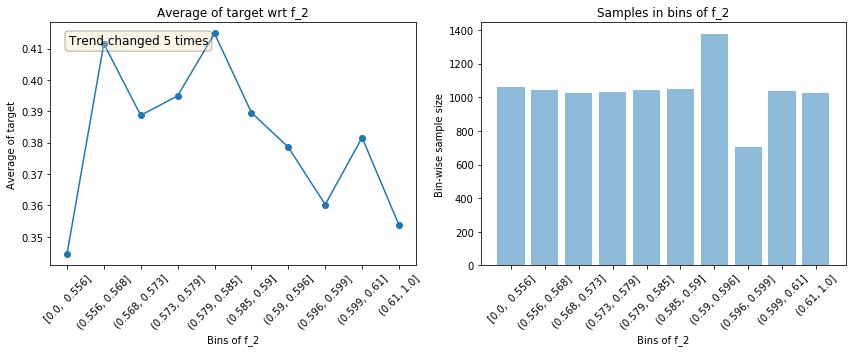

                                           Test data plots                                            


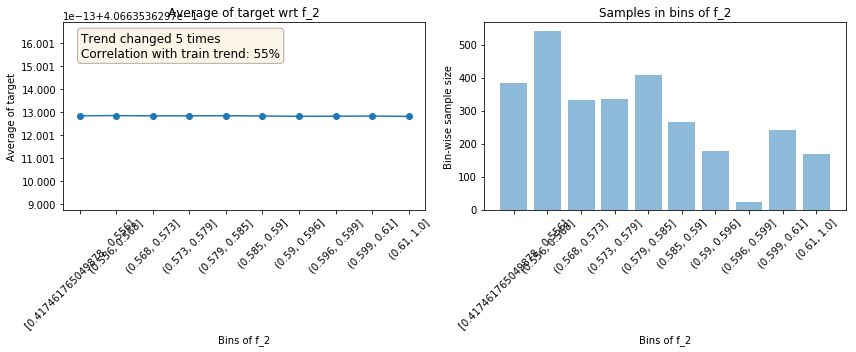

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_3                                             
                                           Train data plots                                           


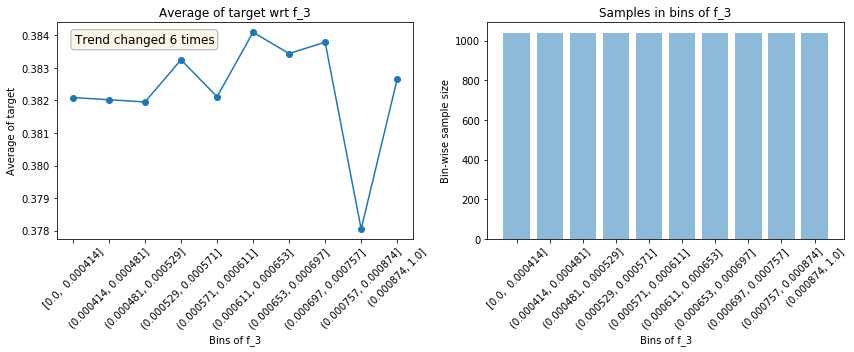

                                           Test data plots                                            


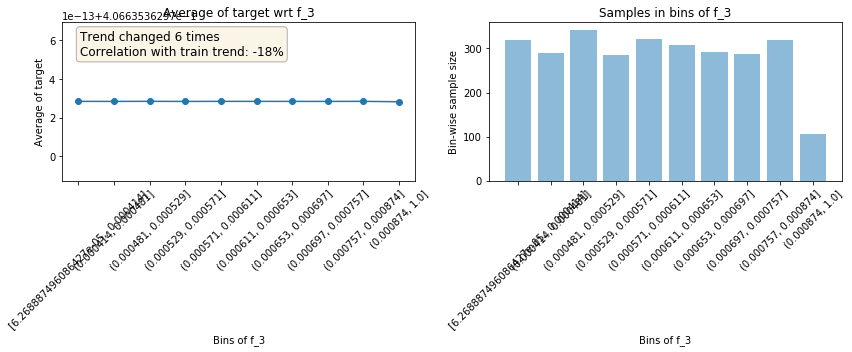

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_4                                             
                                           Train data plots                                           


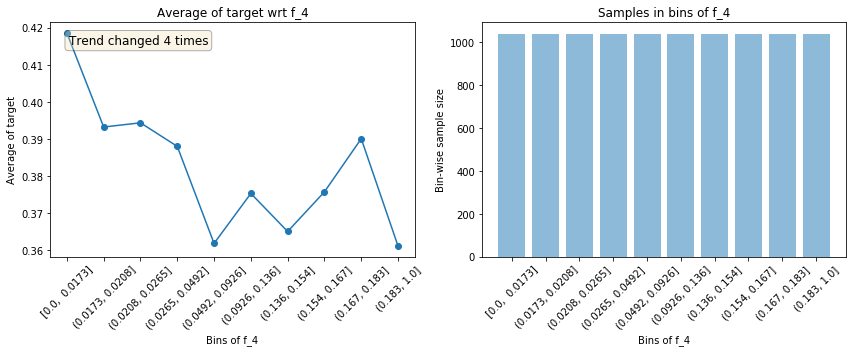

                                           Test data plots                                            


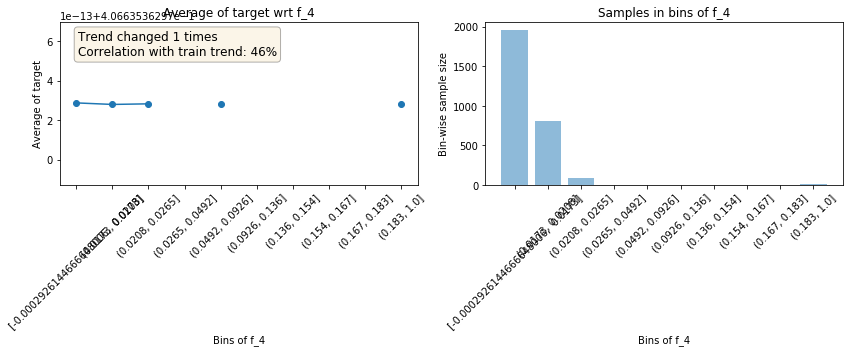

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_5                                             
                                           Train data plots                                           


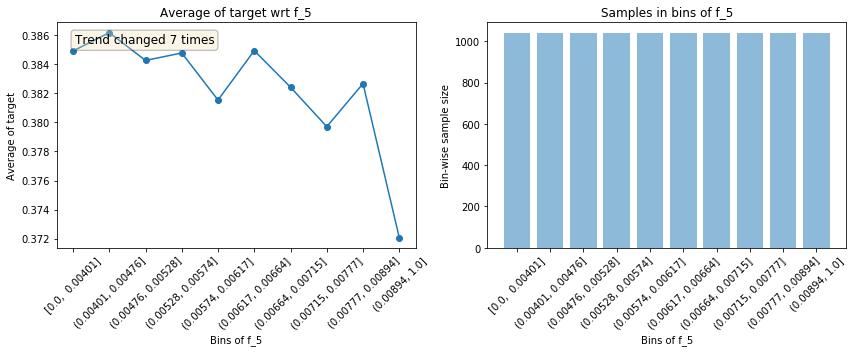

                                           Test data plots                                            


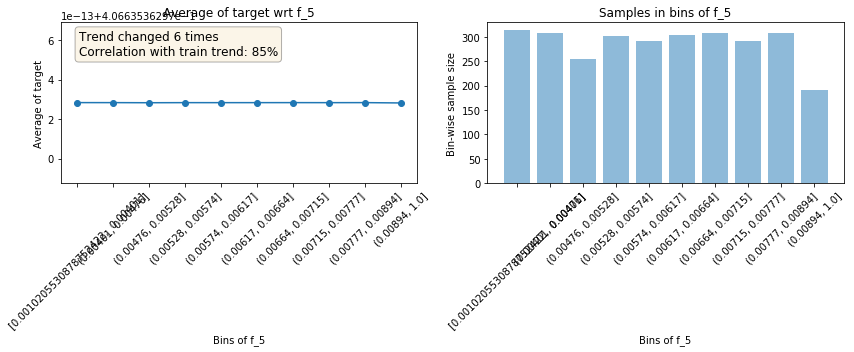

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_6                                             
                                           Train data plots                                           


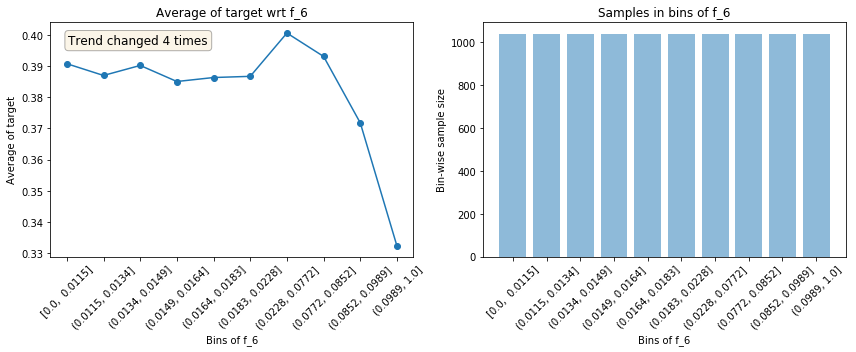

                                           Test data plots                                            


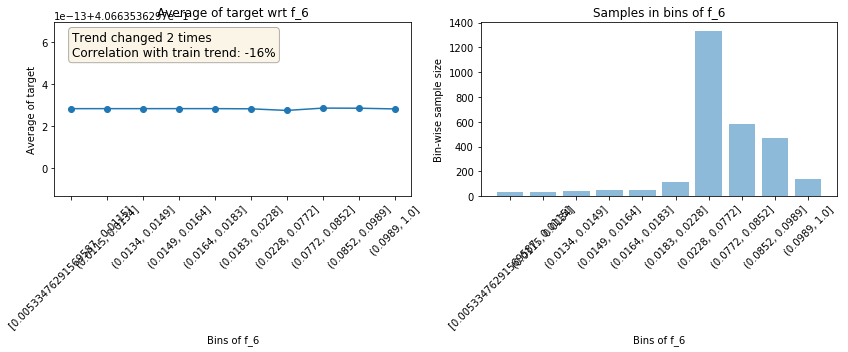

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_7                                             
                                           Train data plots                                           


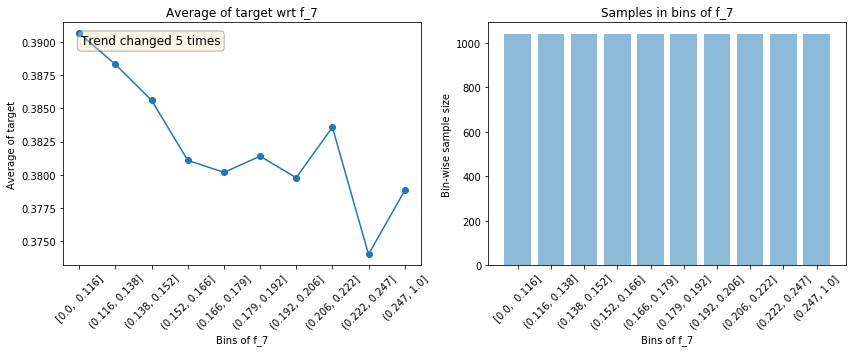

                                           Test data plots                                            


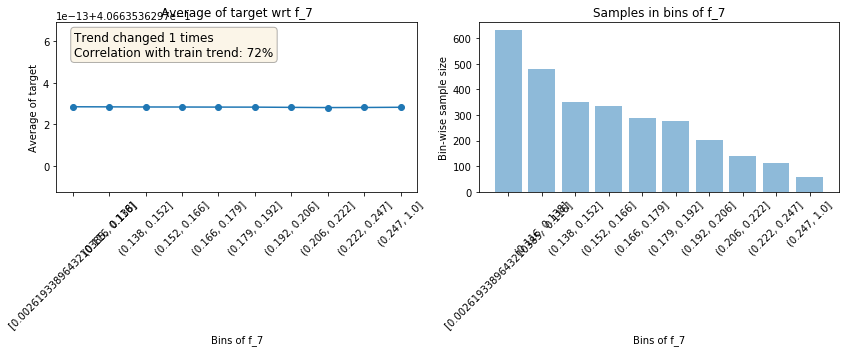

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_8                                             
                                           Train data plots                                           


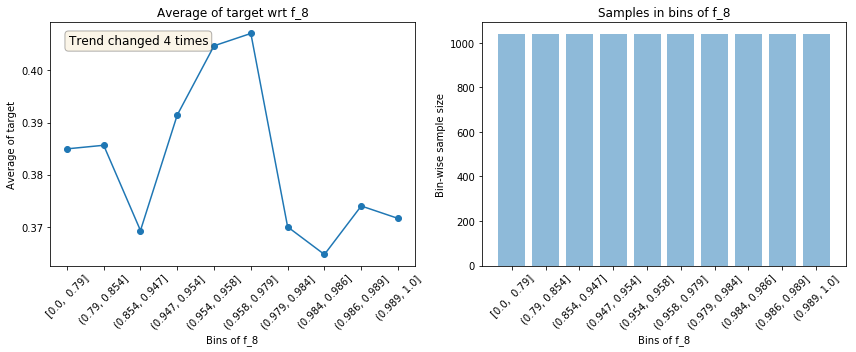

                                           Test data plots                                            


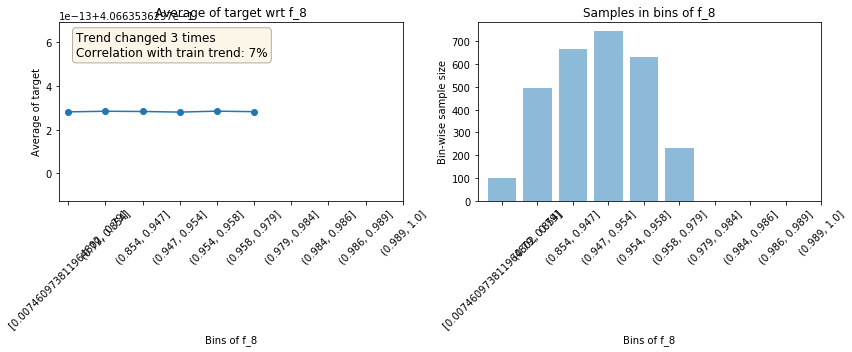

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_9                                             
                                           Train data plots                                           


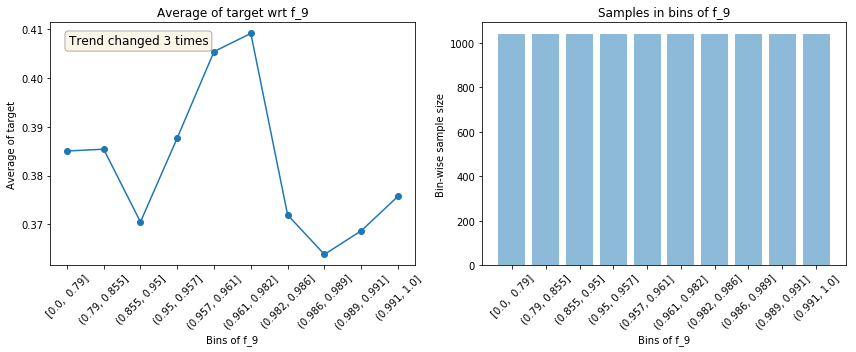

                                           Test data plots                                            


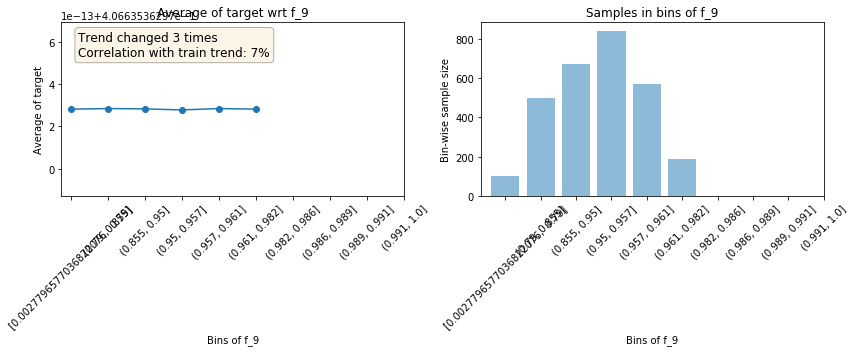

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_10                                            
                                           Train data plots                                           


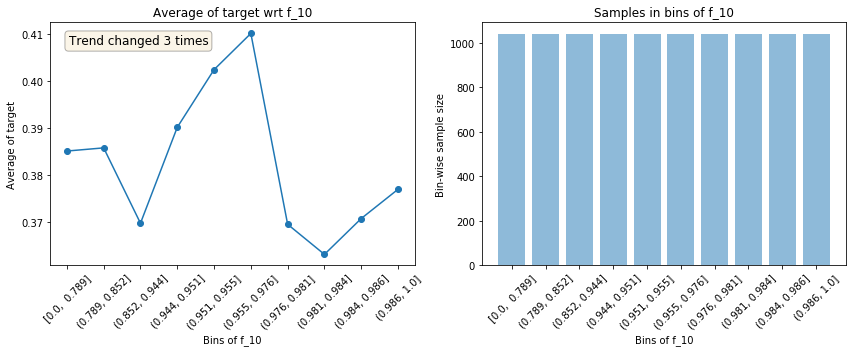

                                           Test data plots                                            


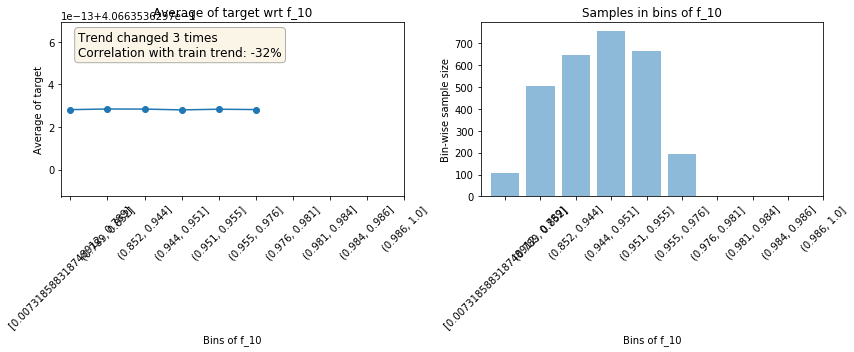

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_11                                            
                                           Train data plots                                           


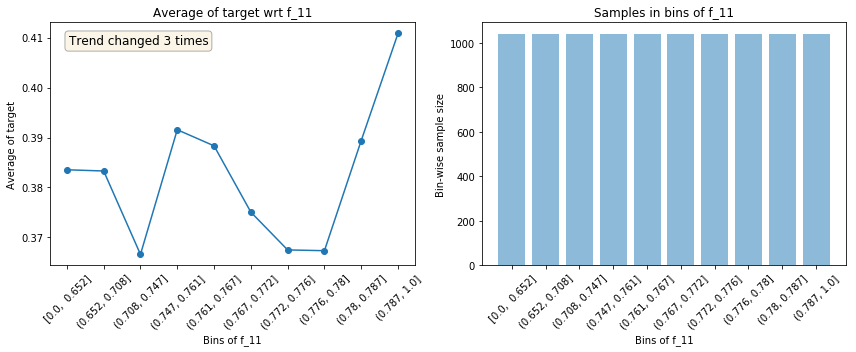

                                           Test data plots                                            


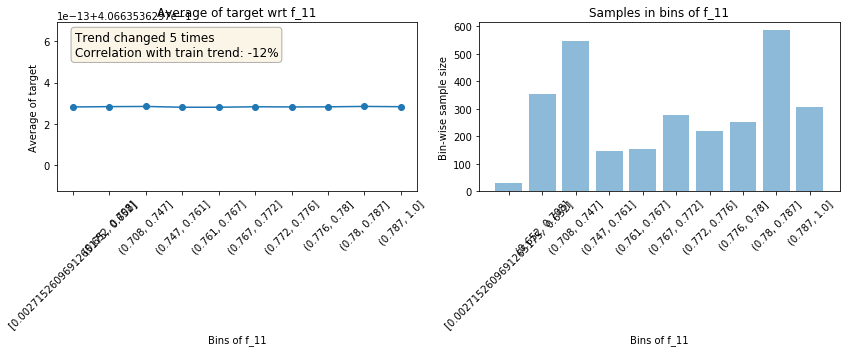

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_12                                            
                                           Train data plots                                           


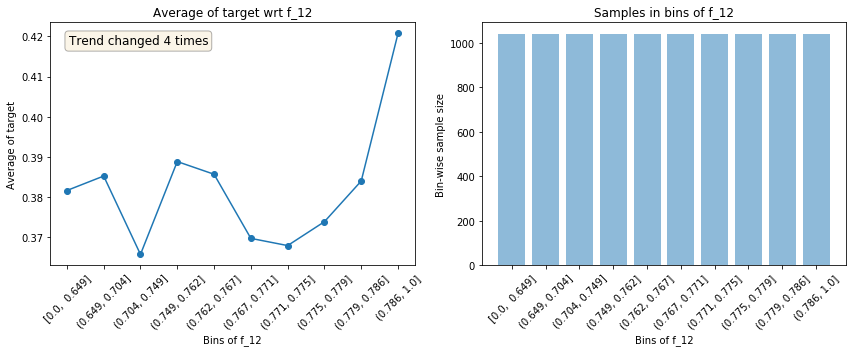

                                           Test data plots                                            


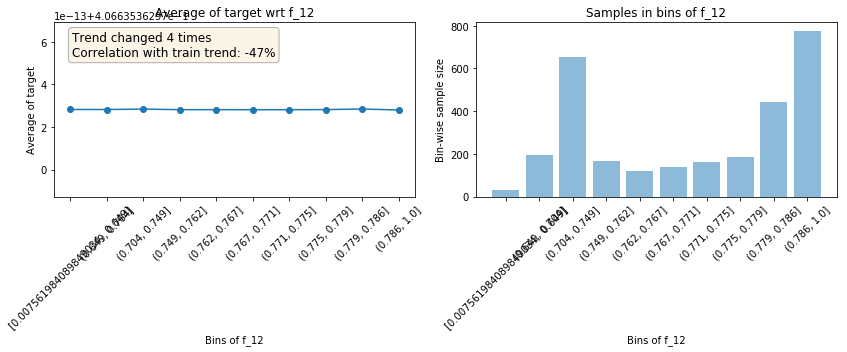

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_13                                            
                                           Train data plots                                           


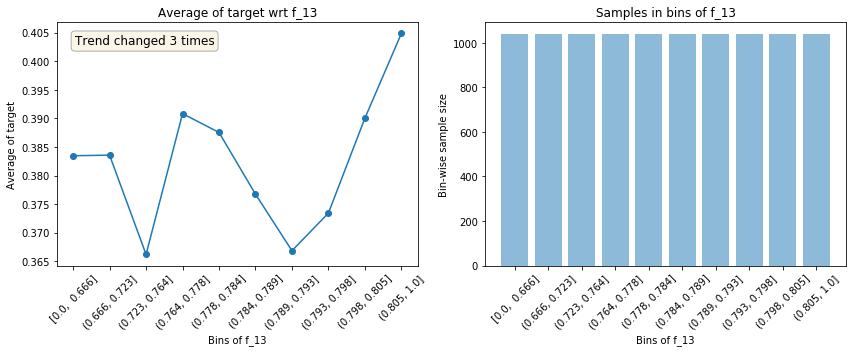

                                           Test data plots                                            


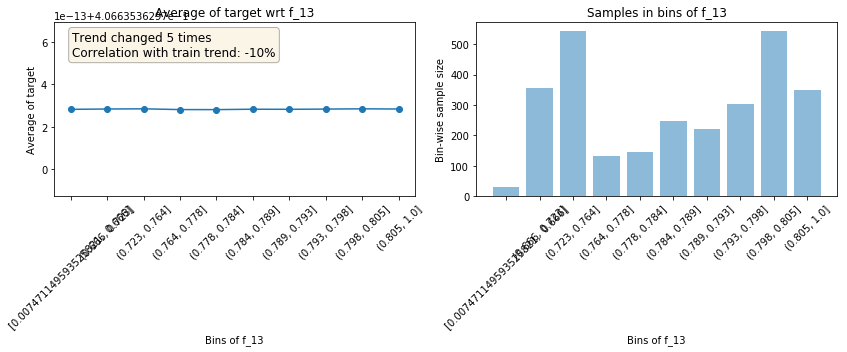

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_14                                            
                                           Train data plots                                           


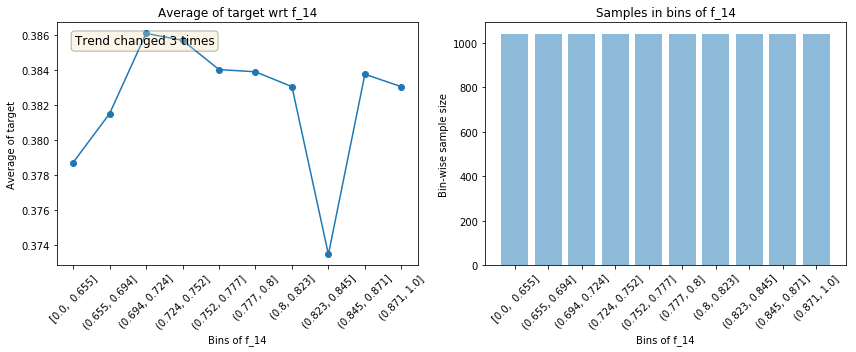

                                           Test data plots                                            


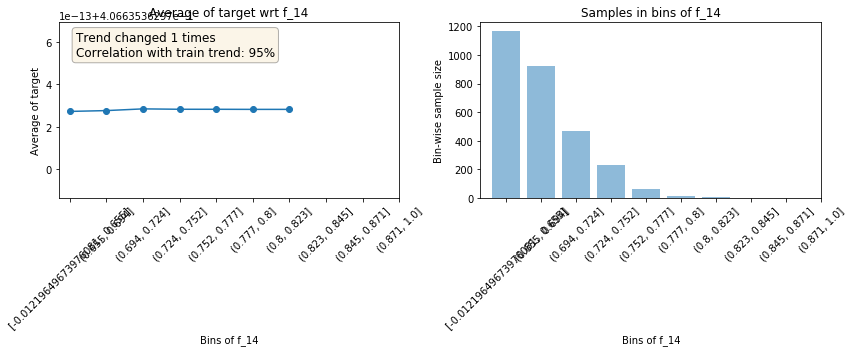

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_15                                            
                                           Train data plots                                           


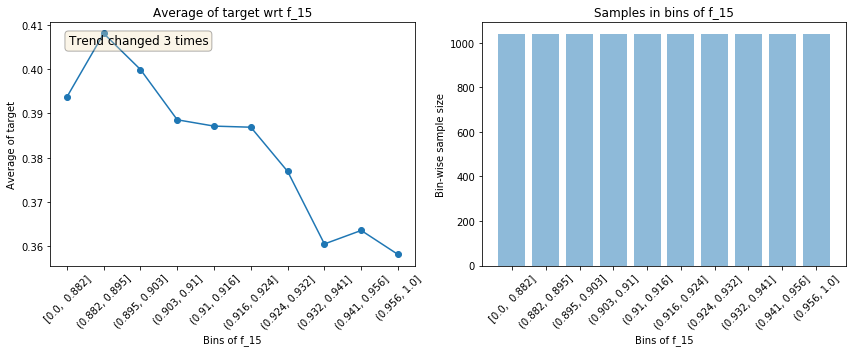

                                           Test data plots                                            


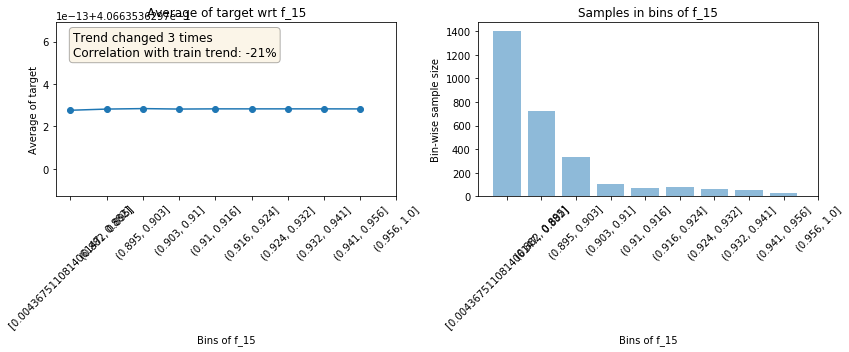

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_16                                            
                                           Train data plots                                           


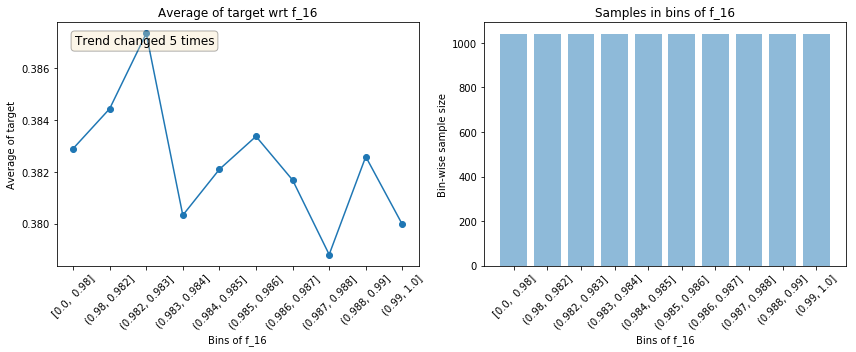

                                           Test data plots                                            


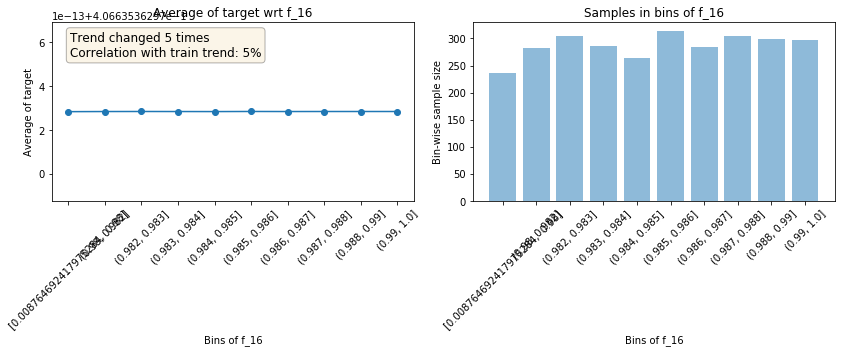

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_17                                            
                                           Train data plots                                           


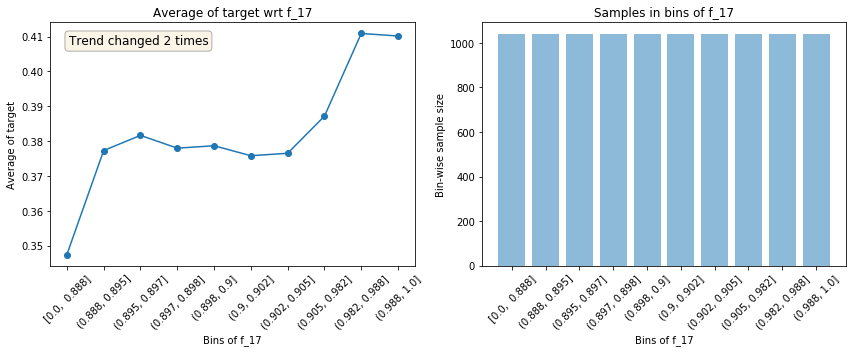

                                           Test data plots                                            


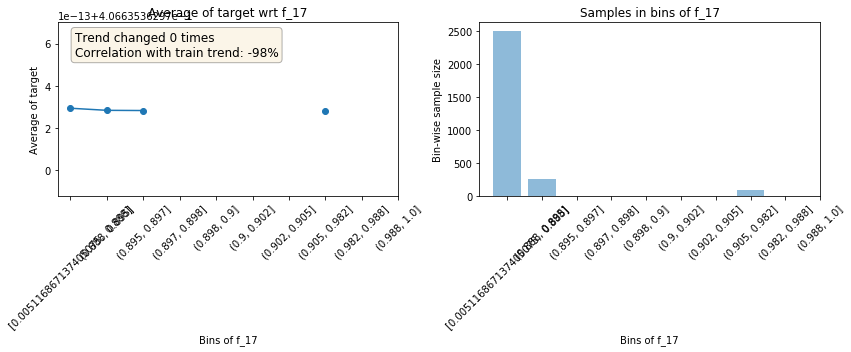

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_18                                            
                                           Train data plots                                           


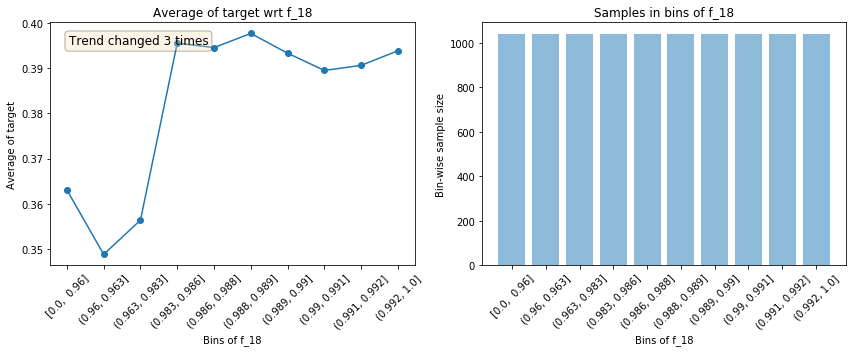

                                           Test data plots                                            


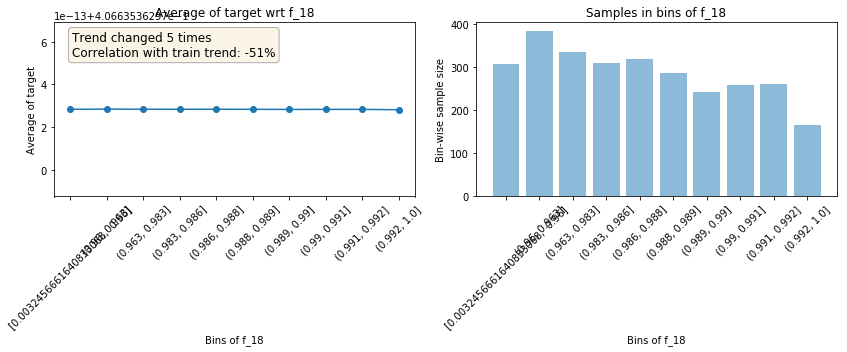

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_19                                            
                                           Train data plots                                           


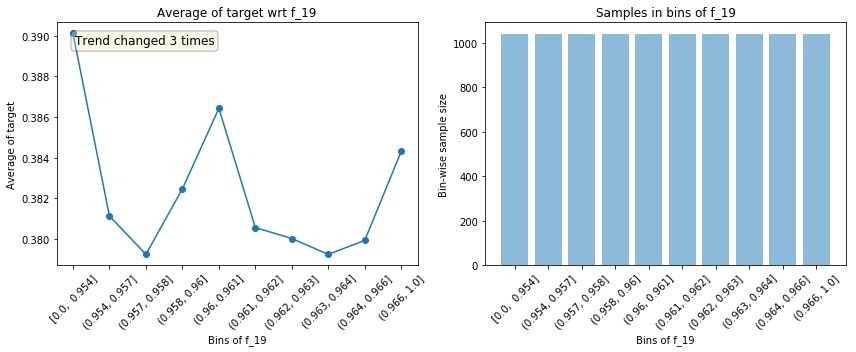

                                           Test data plots                                            


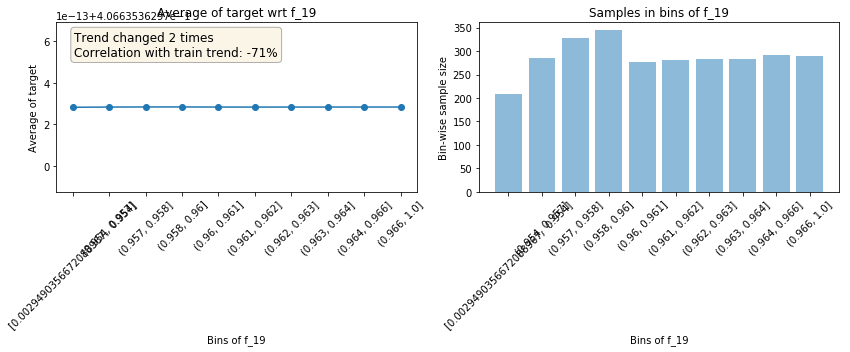

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_20                                            
                                           Train data plots                                           


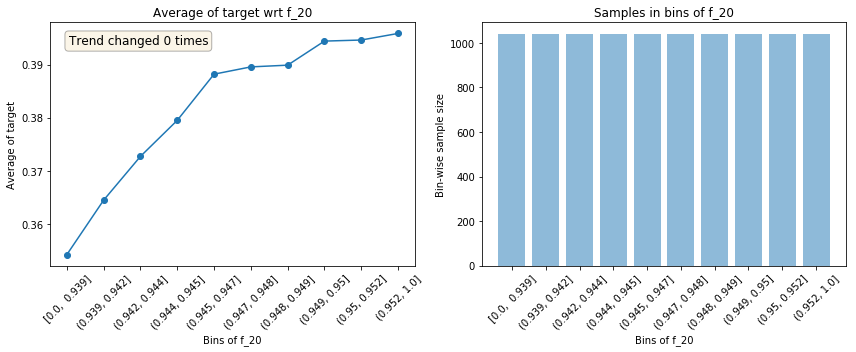

                                           Test data plots                                            


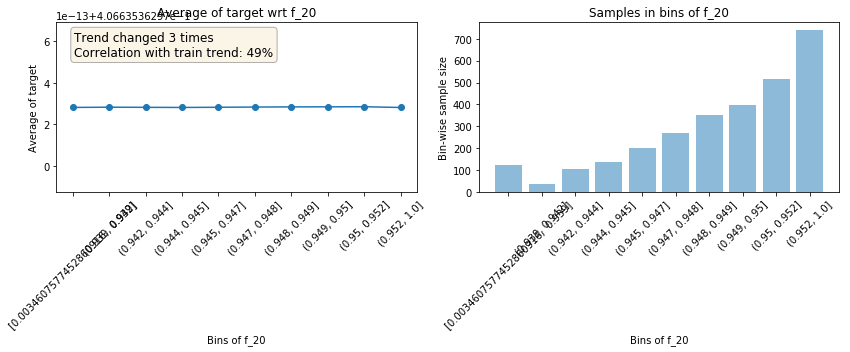

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_21                                            
                                           Train data plots                                           


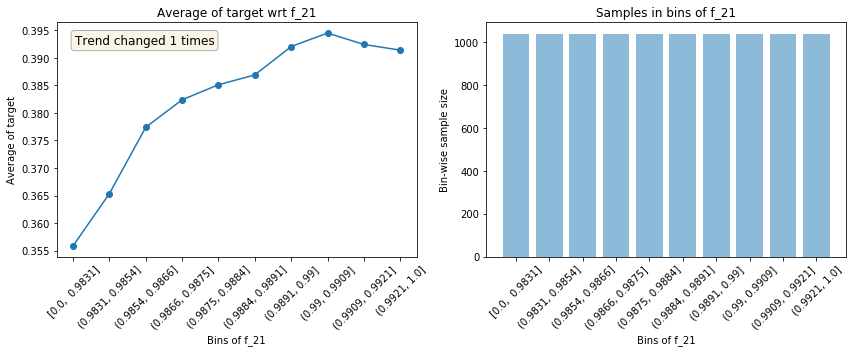

                                           Test data plots                                            


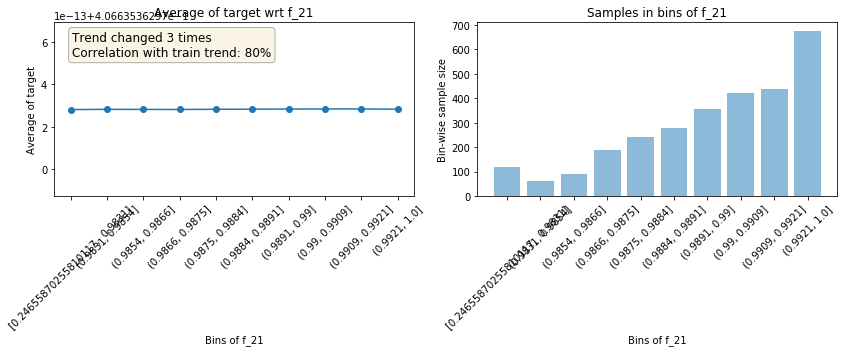

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_22                                            
                                           Train data plots                                           


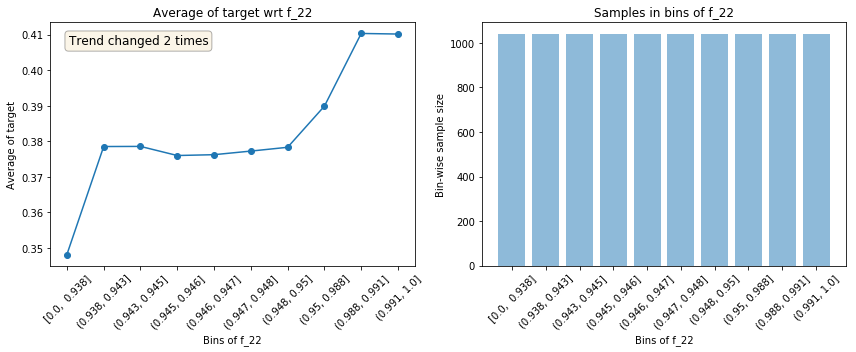

                                           Test data plots                                            


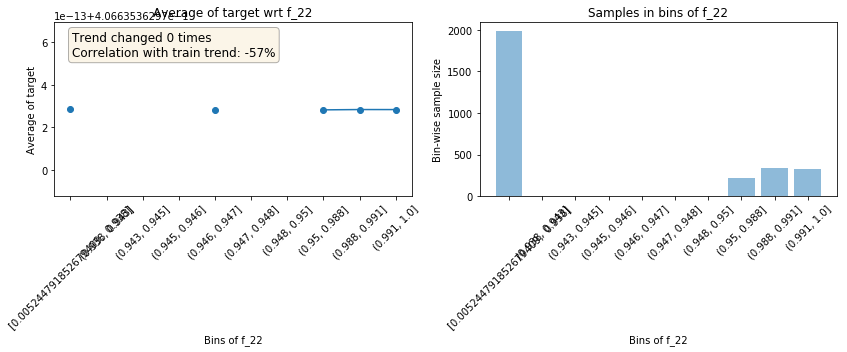

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_23                                            
                                           Train data plots                                           


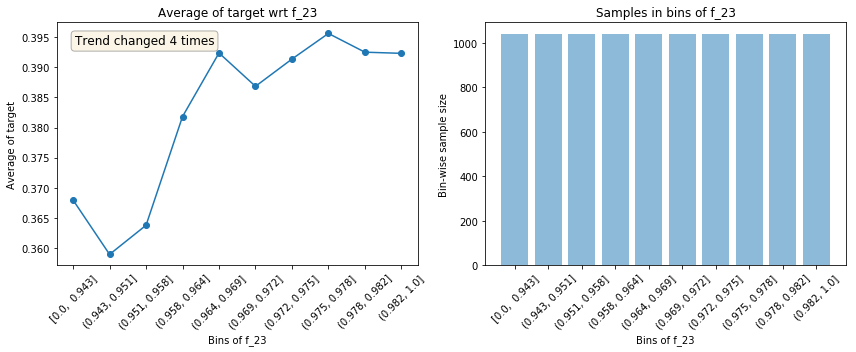

                                           Test data plots                                            


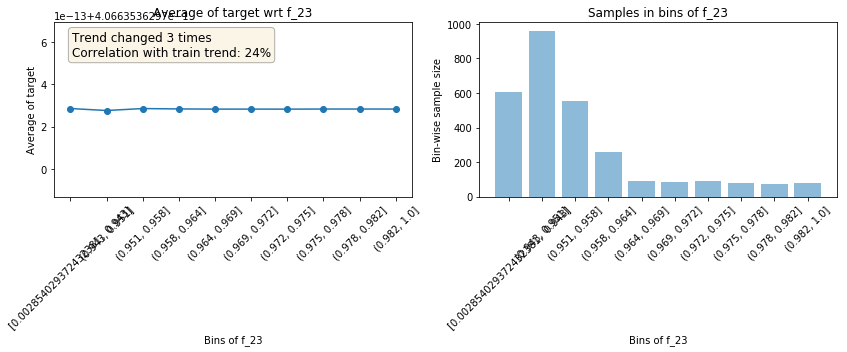

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_24                                            
                                           Train data plots                                           


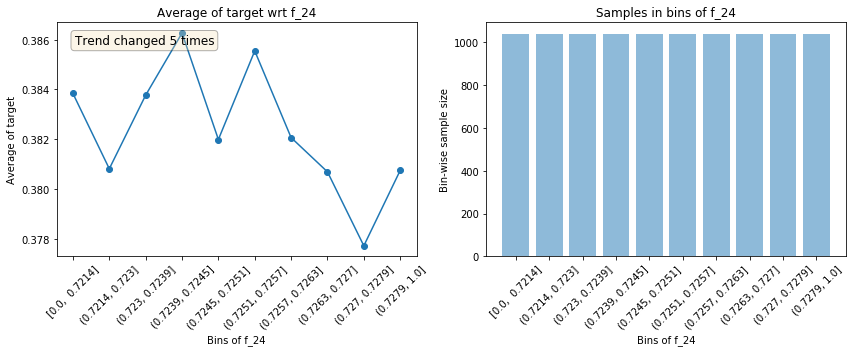

                                           Test data plots                                            


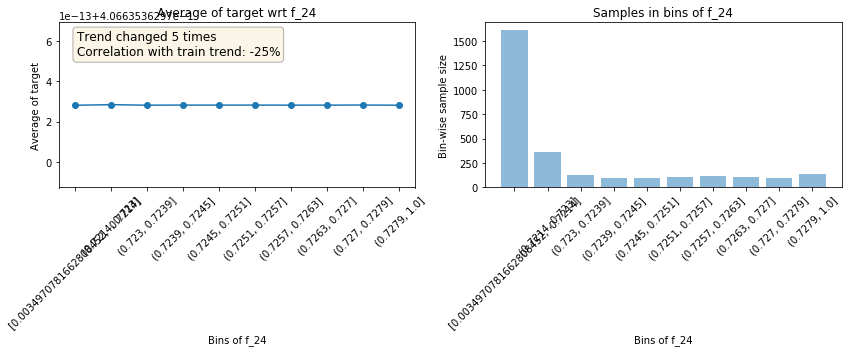

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_25                                            
                                           Train data plots                                           


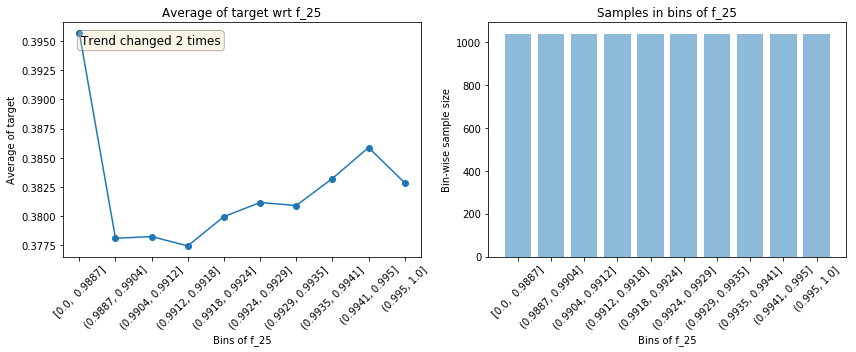

                                           Test data plots                                            


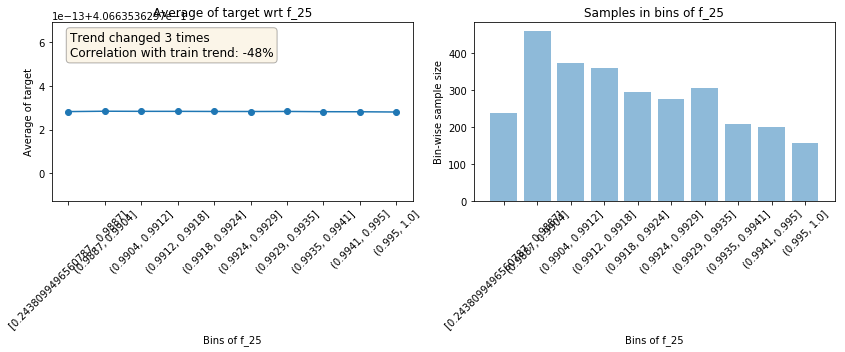

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_26                                            
                                           Train data plots                                           


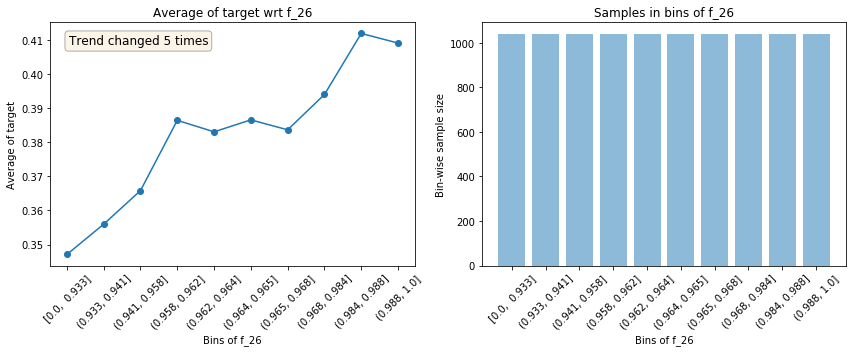

                                           Test data plots                                            


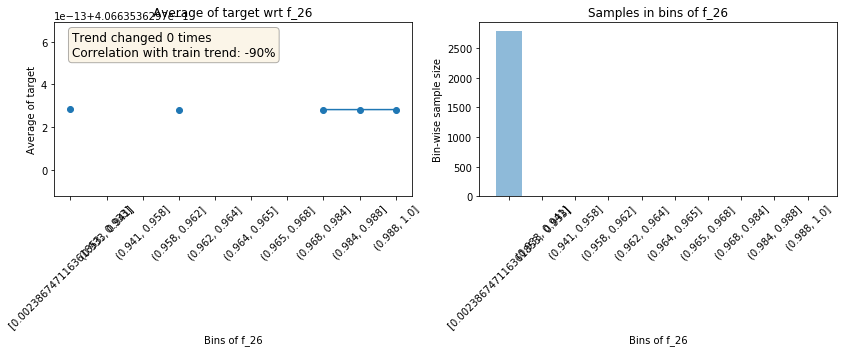

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_27                                            
                                           Train data plots                                           


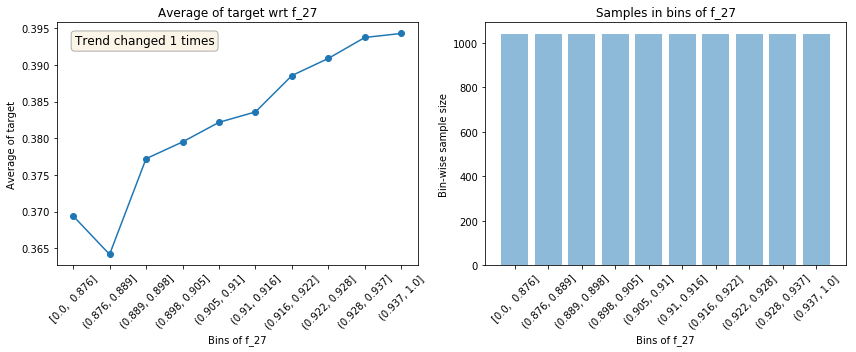

                                           Test data plots                                            


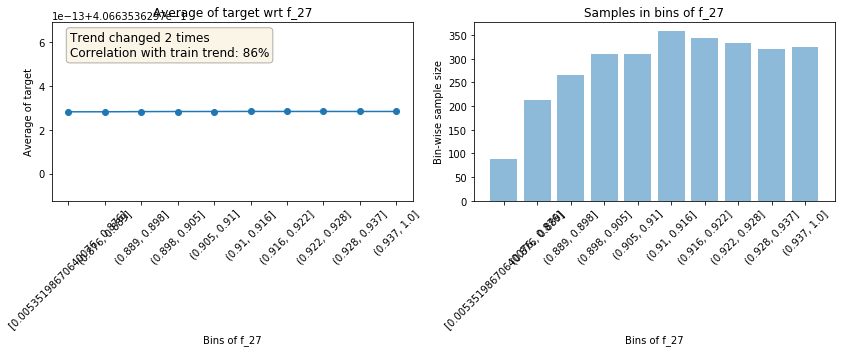

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_28                                            
                                           Train data plots                                           


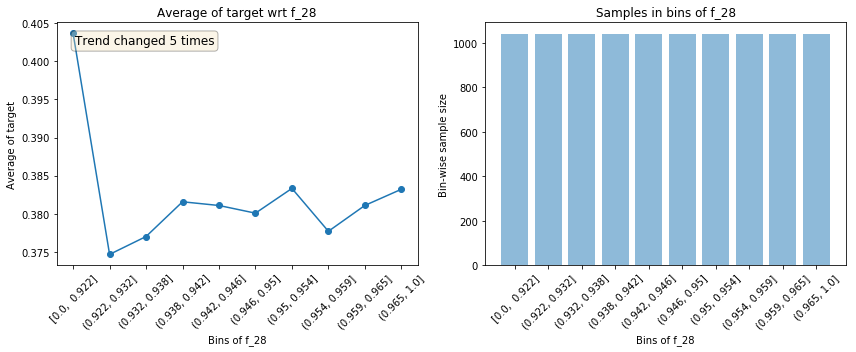

                                           Test data plots                                            


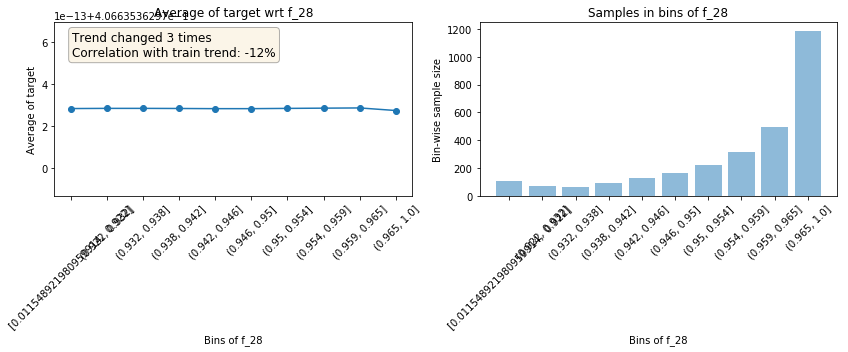

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_29                                            
                                           Train data plots                                           


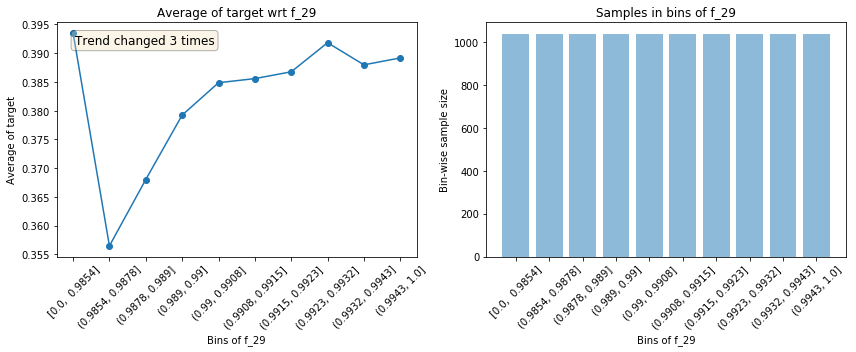

                                           Test data plots                                            


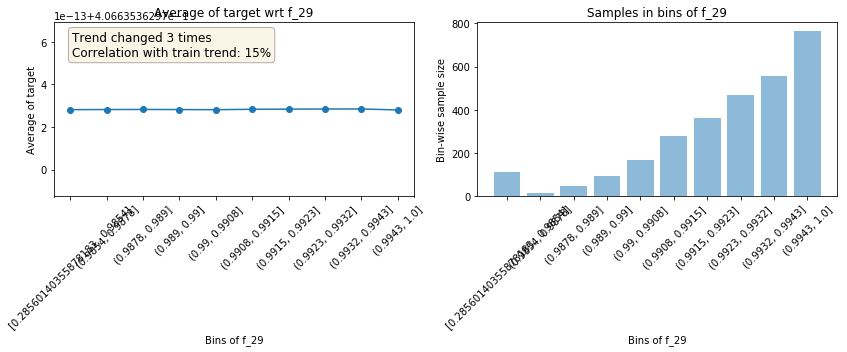

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_30                                            
                                           Train data plots                                           


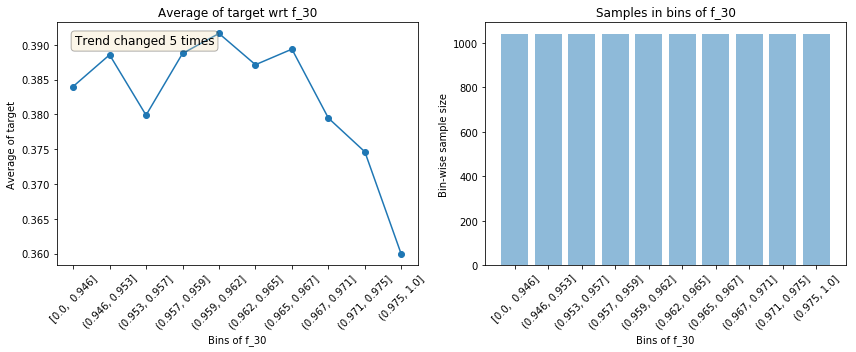

                                           Test data plots                                            


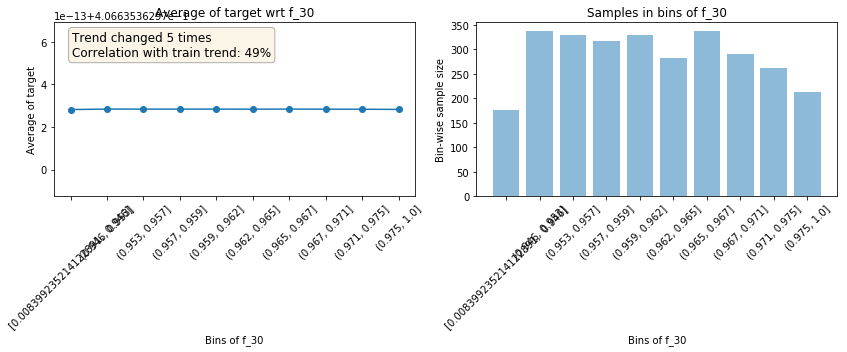

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_31                                            
                                           Train data plots                                           


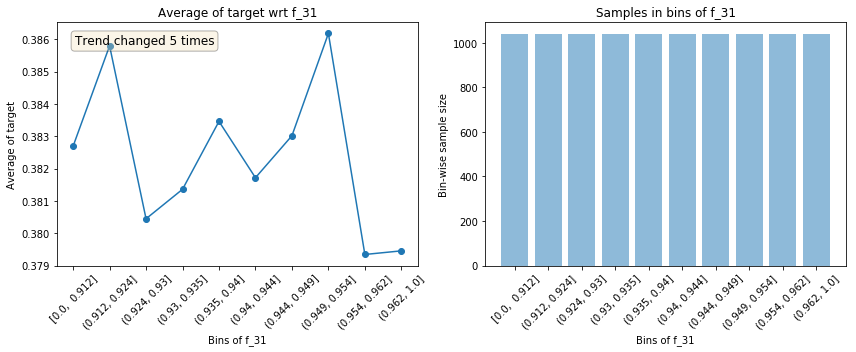

                                           Test data plots                                            


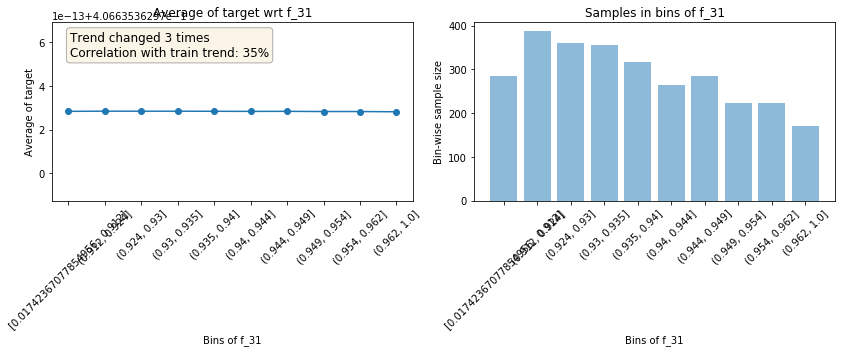

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_32                                            
                                           Train data plots                                           


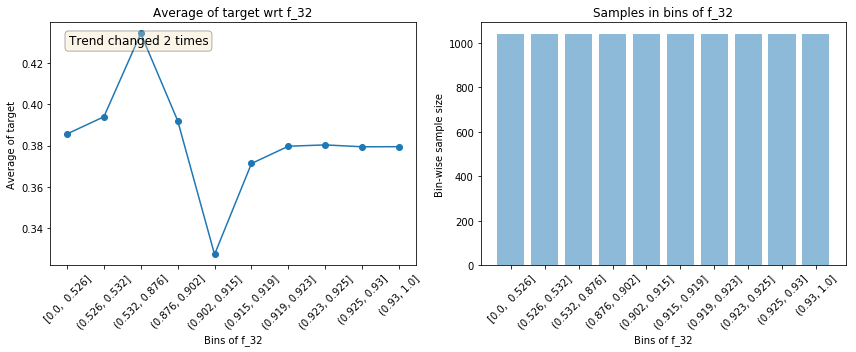

                                           Test data plots                                            


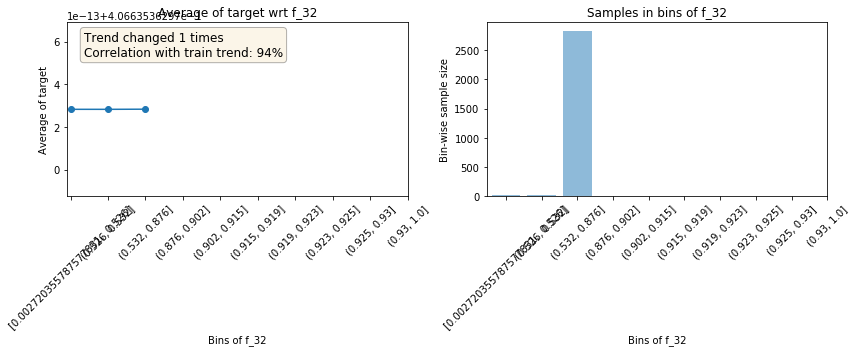

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_33                                            
                                           Train data plots                                           


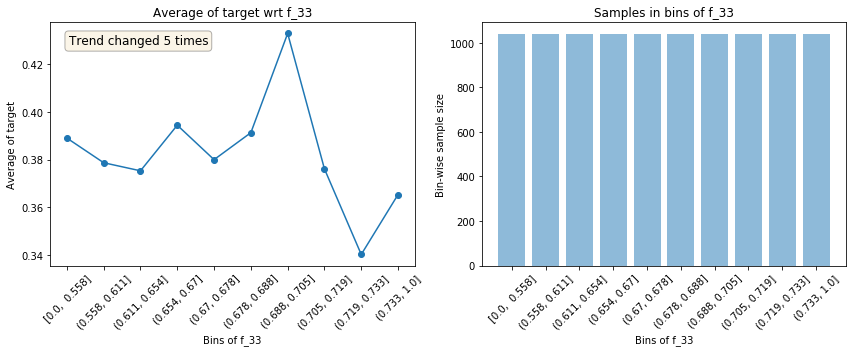

                                           Test data plots                                            


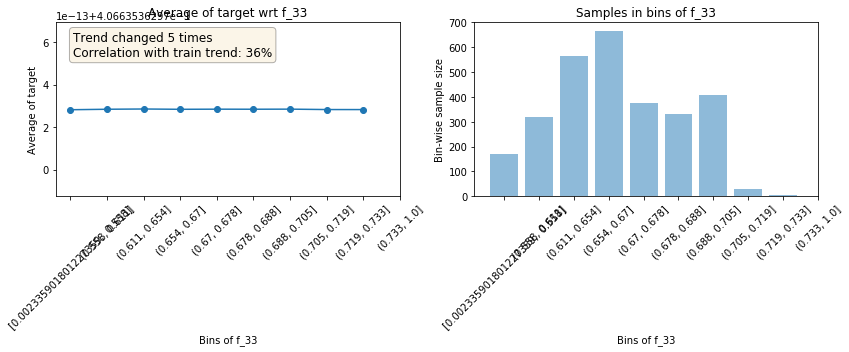

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_34                                            
                                           Train data plots                                           


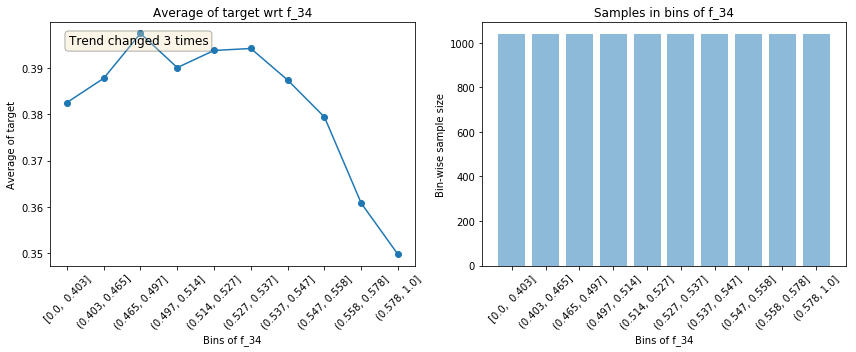

                                           Test data plots                                            


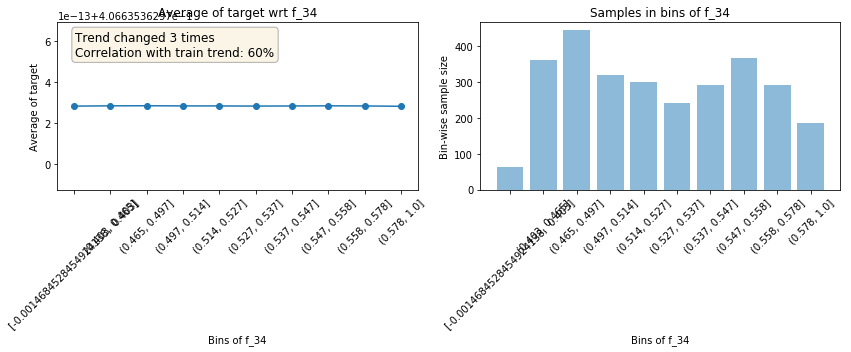

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_35                                            
                                           Train data plots                                           


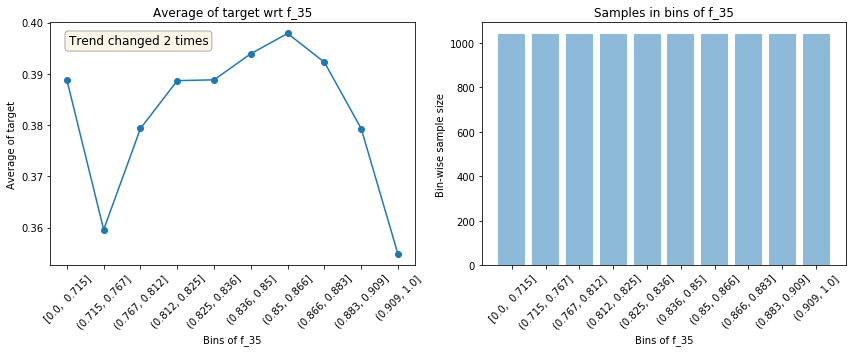

                                           Test data plots                                            


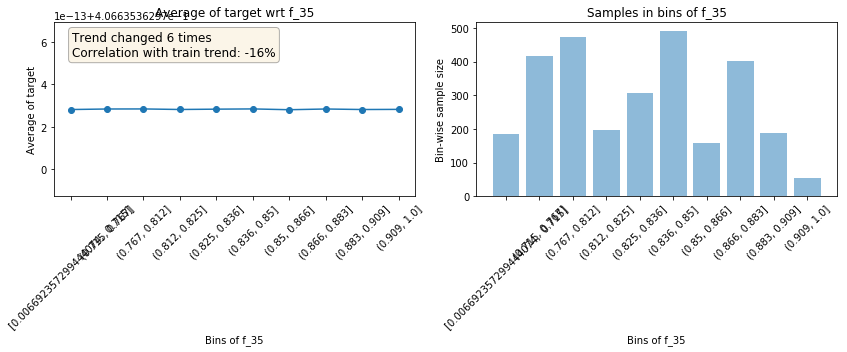

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_36                                            
                                           Train data plots                                           


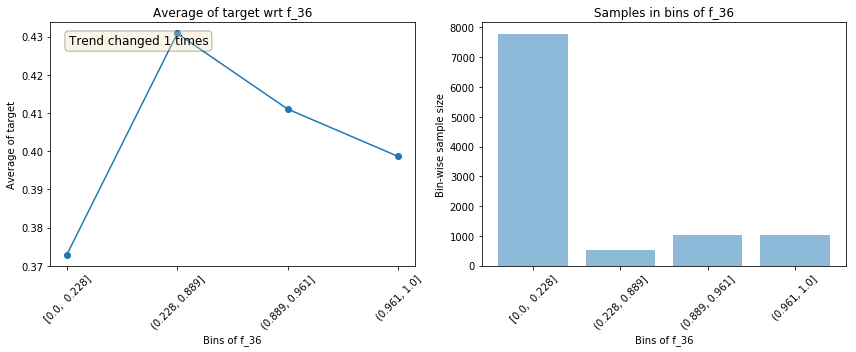

                                           Test data plots                                            


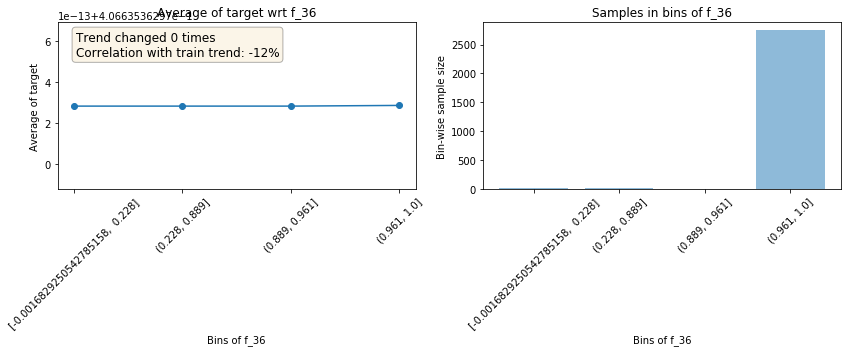

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_38                                            
                                           Train data plots                                           


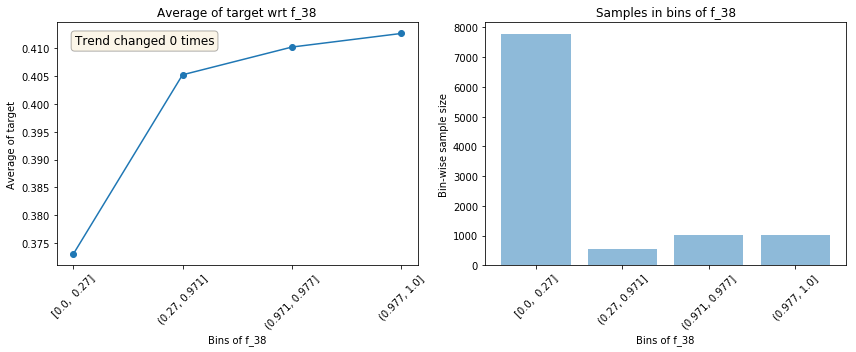

                                           Test data plots                                            


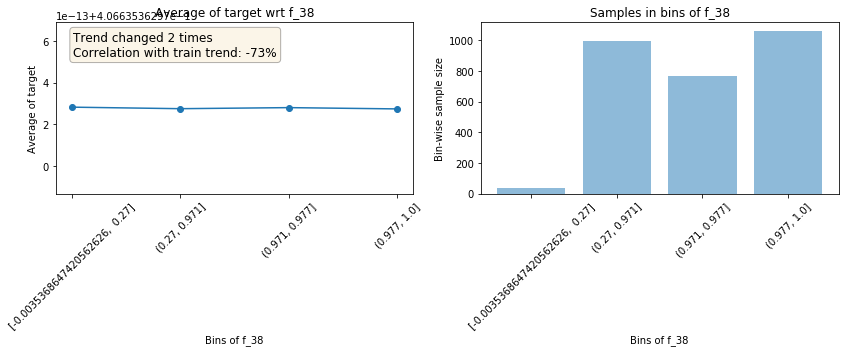

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_39                                            
                                           Train data plots                                           


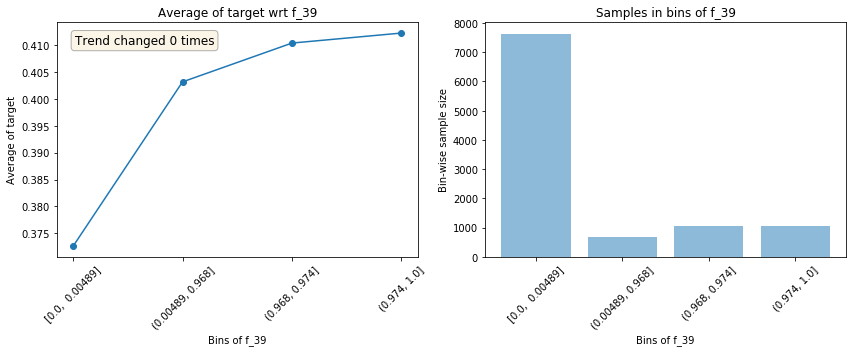

                                           Test data plots                                            


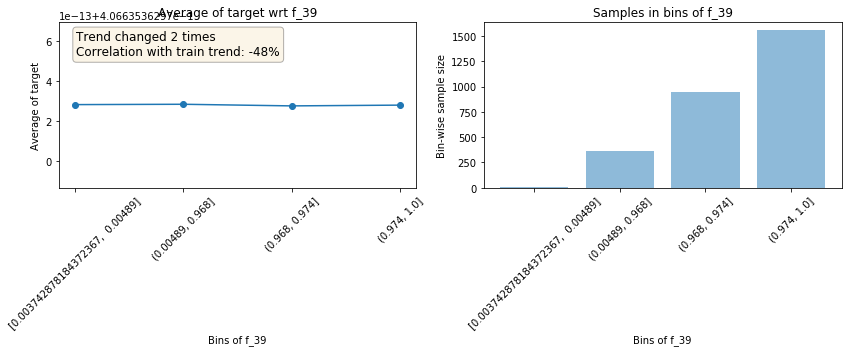

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_40                                            
                                           Train data plots                                           


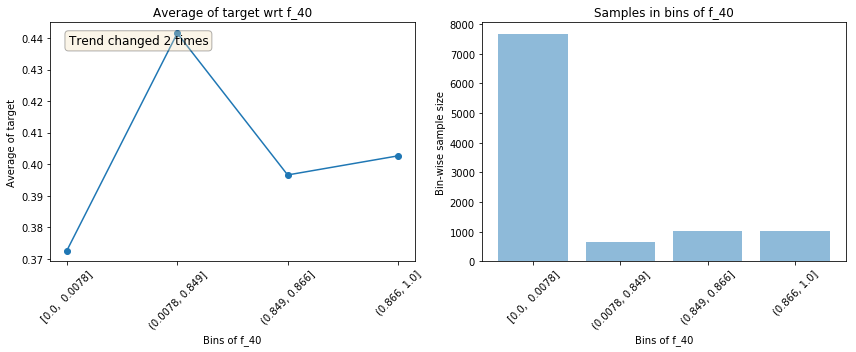

                                           Test data plots                                            


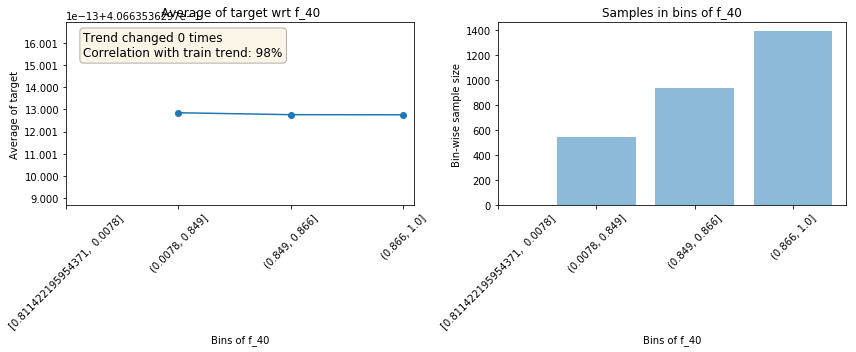

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_41                                            
                                           Train data plots                                           


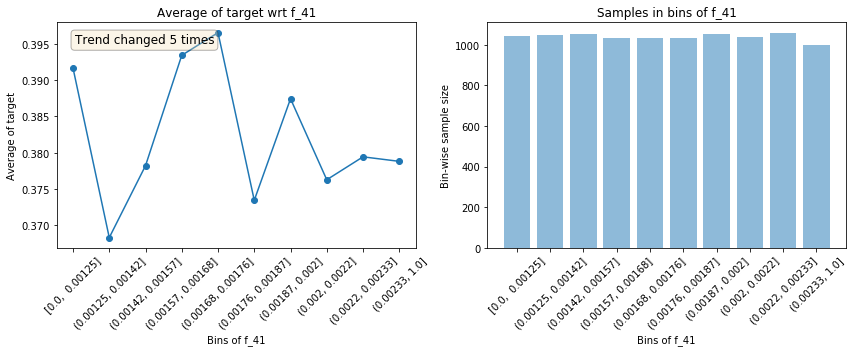

                                           Test data plots                                            


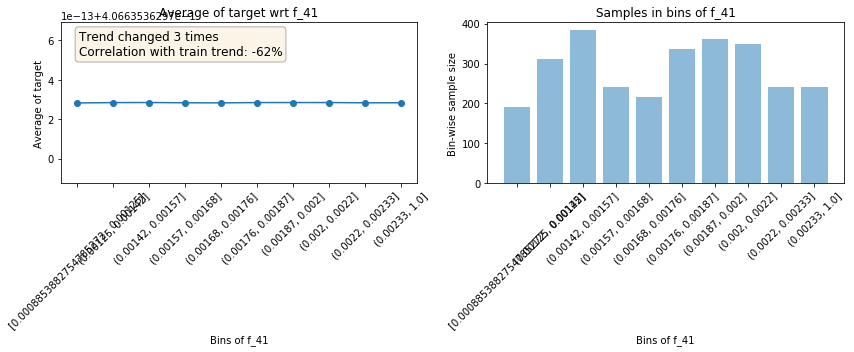

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_42                                            
                                           Train data plots                                           


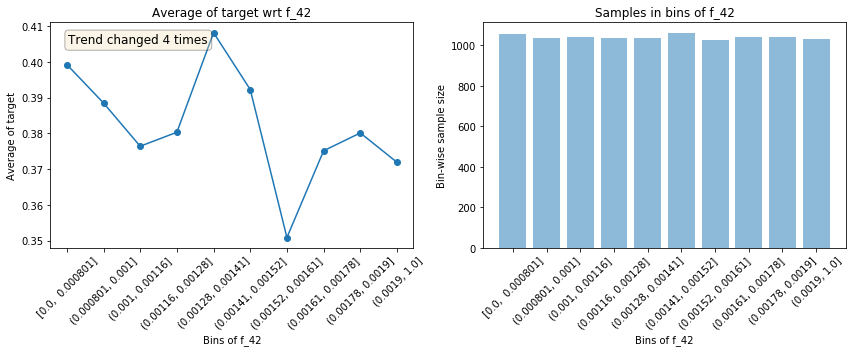

                                           Test data plots                                            


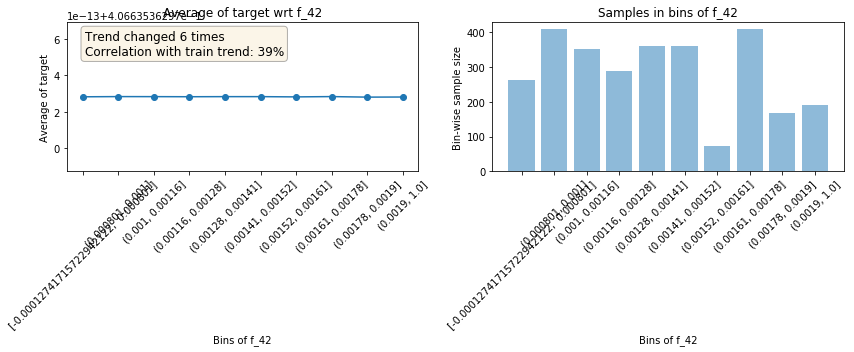

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_43                                            
                                           Train data plots                                           


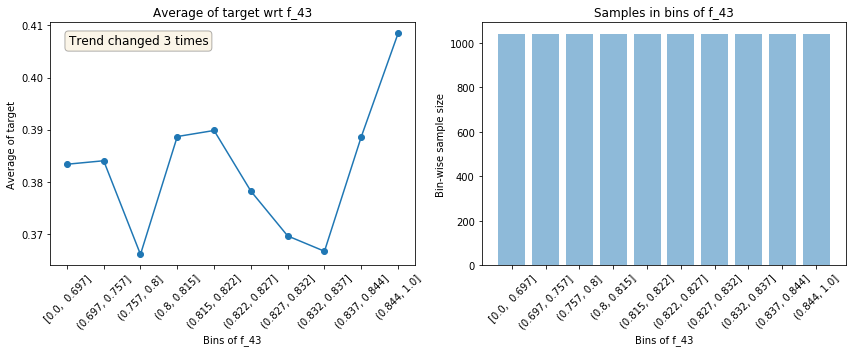

                                           Test data plots                                            


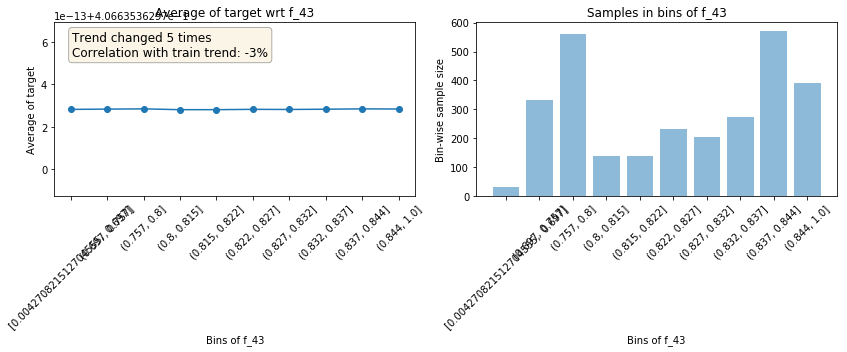

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_44                                            
                                           Train data plots                                           


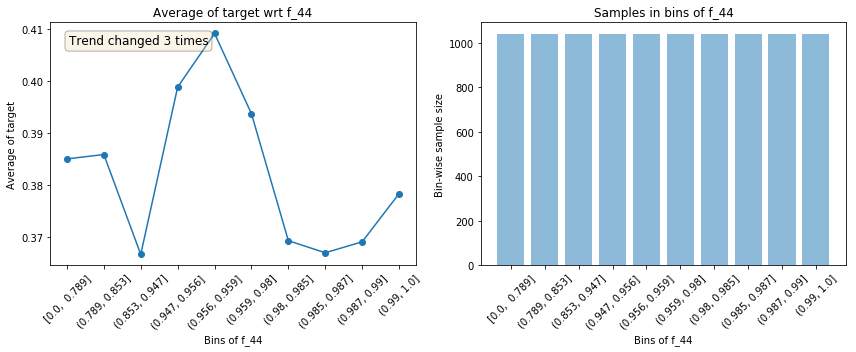

                                           Test data plots                                            


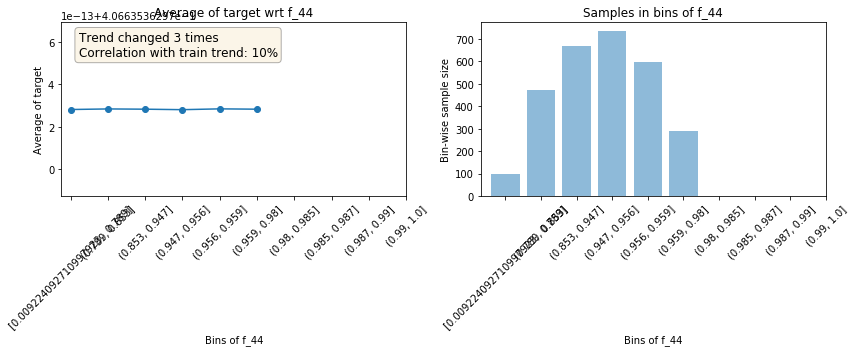

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_45                                            
                                           Train data plots                                           


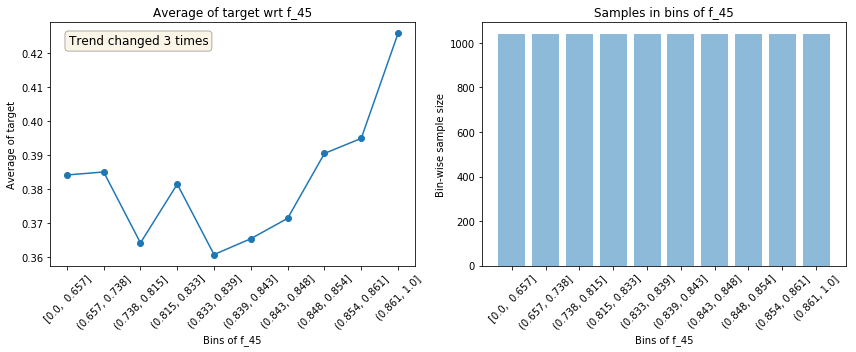

                                           Test data plots                                            


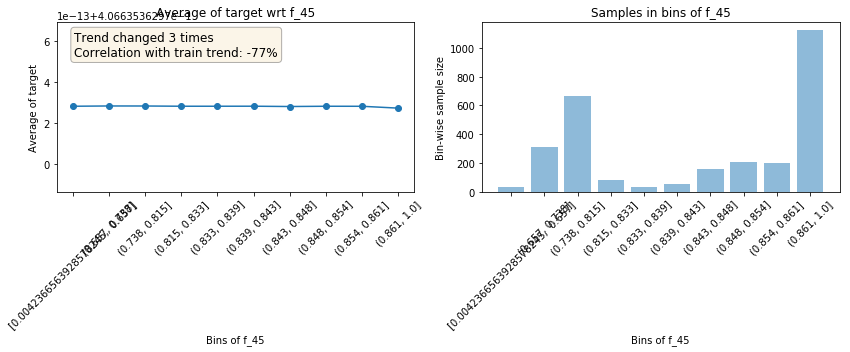

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_46                                            
                                           Train data plots                                           


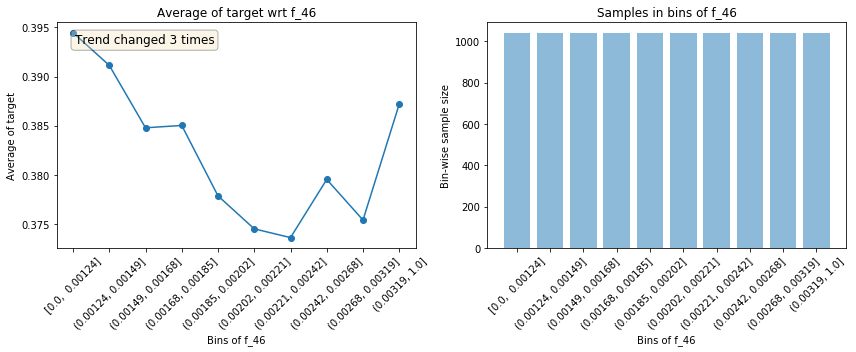

                                           Test data plots                                            


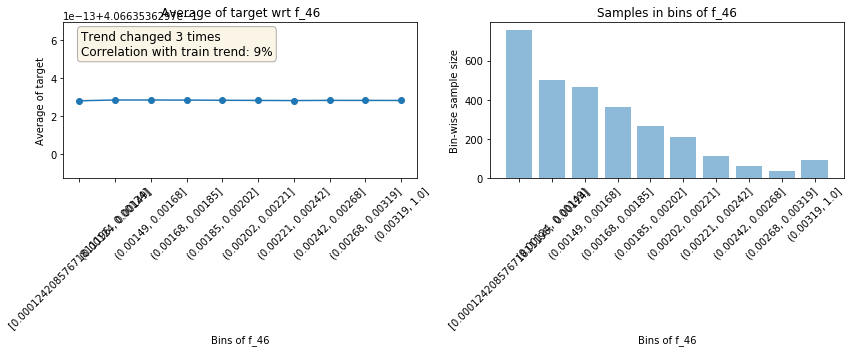

--------------------------------------------------------------------------------------------------------------


                                            Plots for f_47                                            
                                           Train data plots                                           


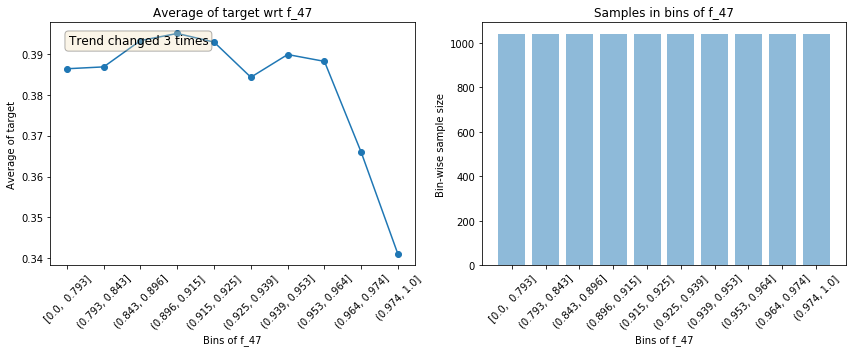

                                           Test data plots                                            


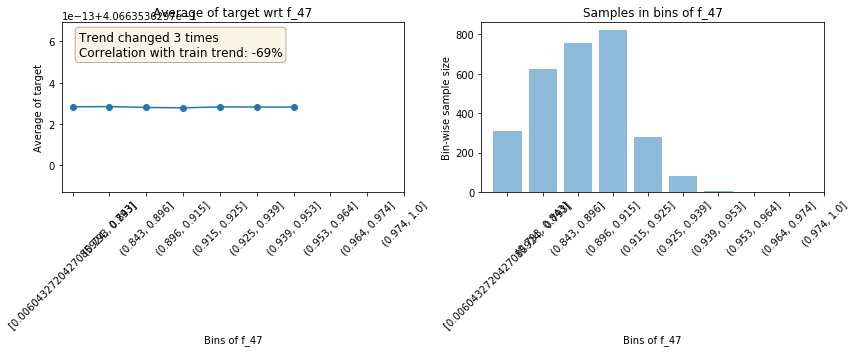

--------------------------------------------------------------------------------------------------------------


                                            Plots for hour                                            
                                           Train data plots                                           


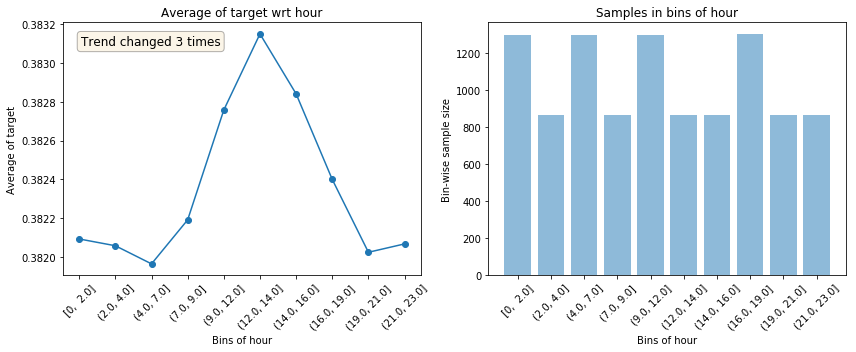

                                           Test data plots                                            


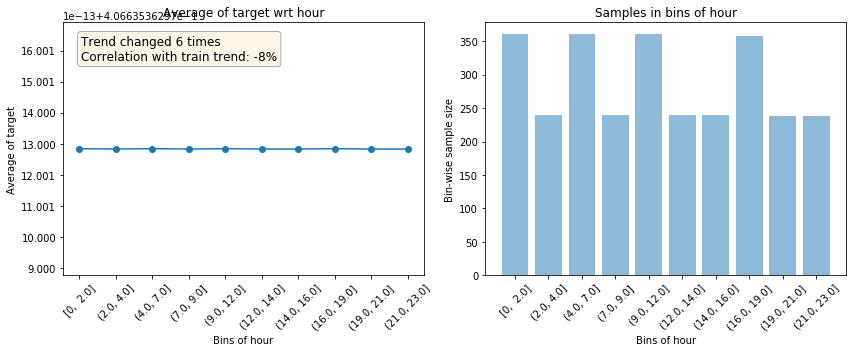

--------------------------------------------------------------------------------------------------------------


                                            Plots for day                                             
                                           Train data plots                                           


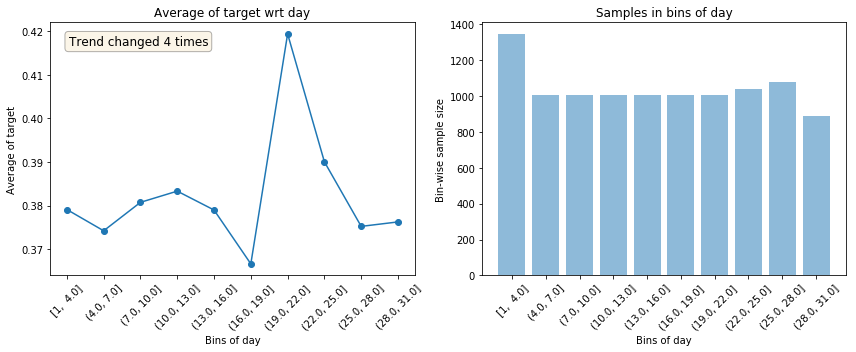

                                           Test data plots                                            


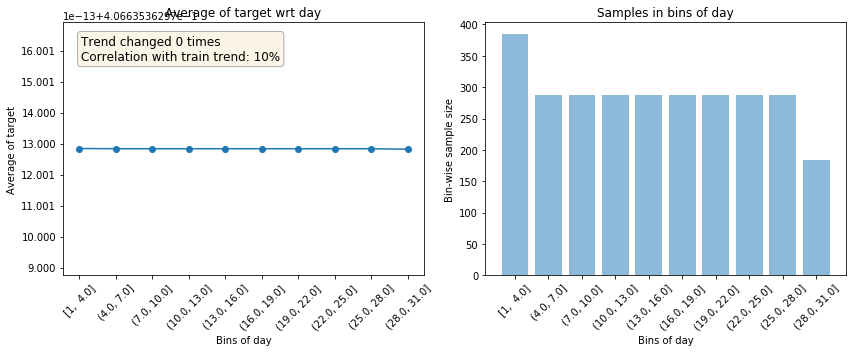

--------------------------------------------------------------------------------------------------------------


                                          Plots for weekday                                           
                                           Train data plots                                           


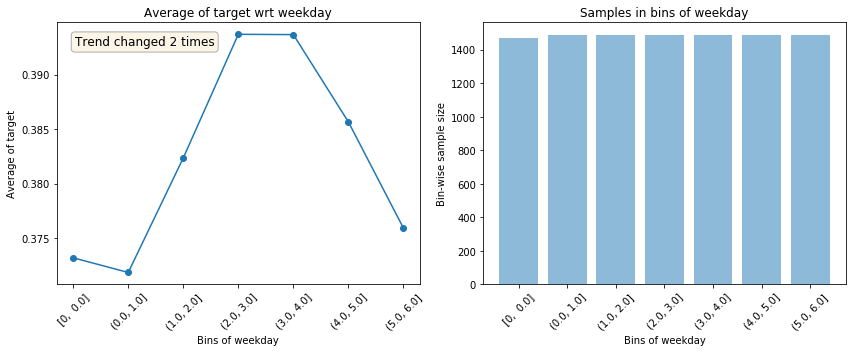

                                           Test data plots                                            


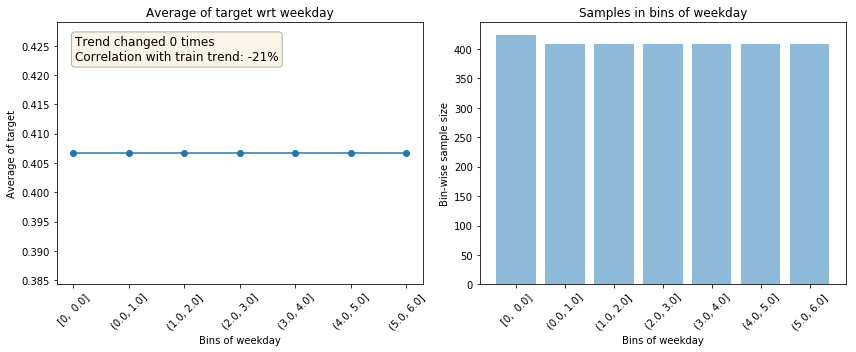

--------------------------------------------------------------------------------------------------------------


                                           Plots for month                                            
                                           Train data plots                                           


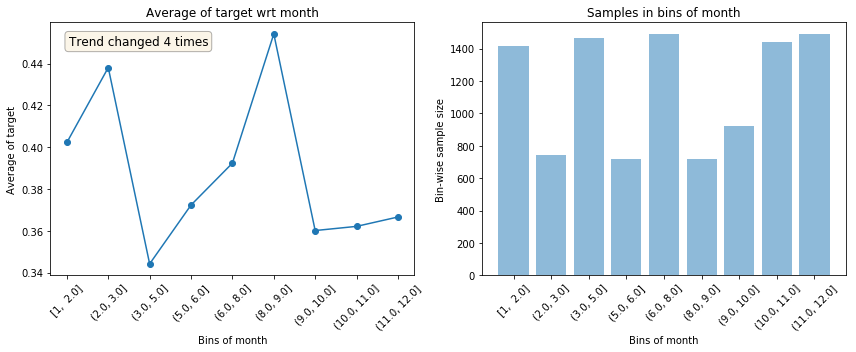

                                           Test data plots                                            


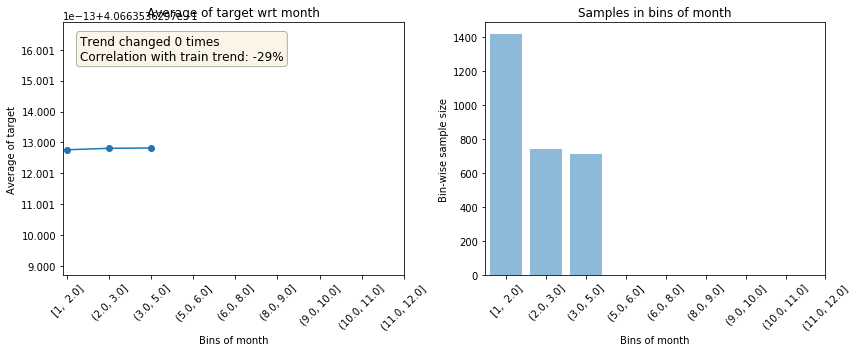

--------------------------------------------------------------------------------------------------------------


                                         Plots for is_weekend                                         
                                           Train data plots                                           


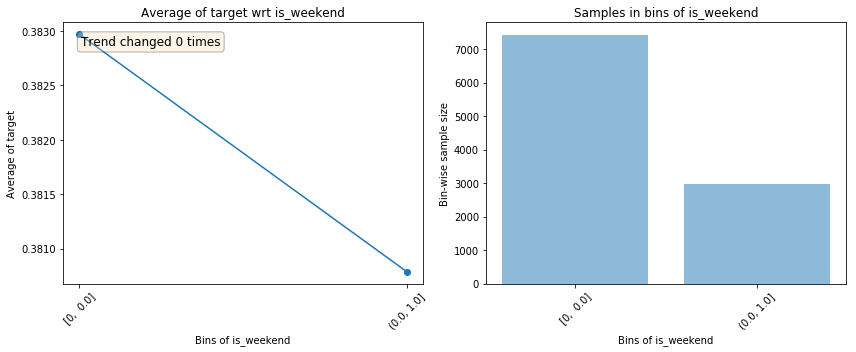

                                           Test data plots                                            


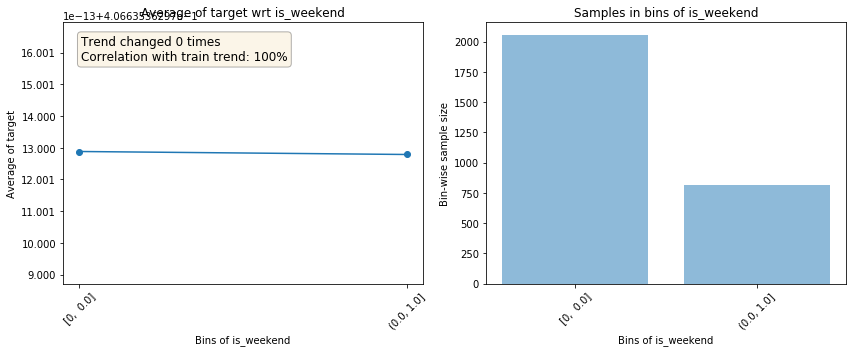

--------------------------------------------------------------------------------------------------------------


                                             Plots for s1                                             
                                           Train data plots                                           


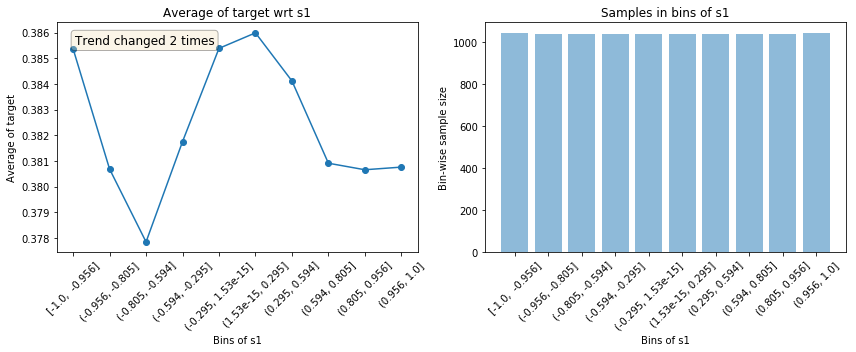

                                           Test data plots                                            


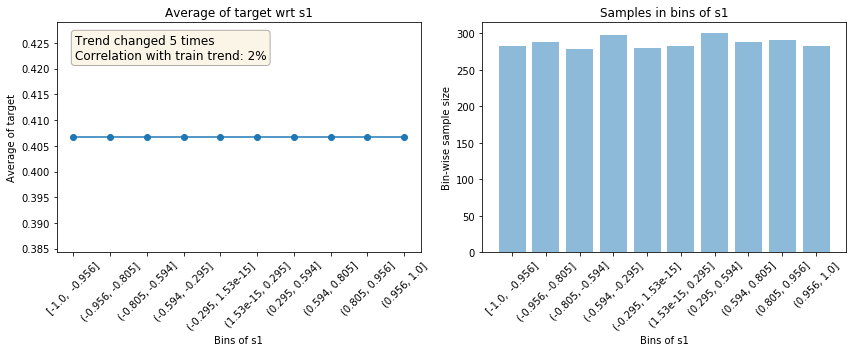

--------------------------------------------------------------------------------------------------------------


                                             Plots for c1                                             
                                           Train data plots                                           


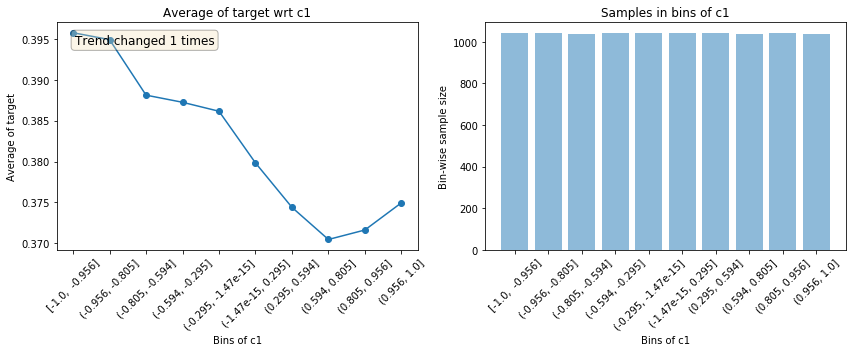

                                           Test data plots                                            


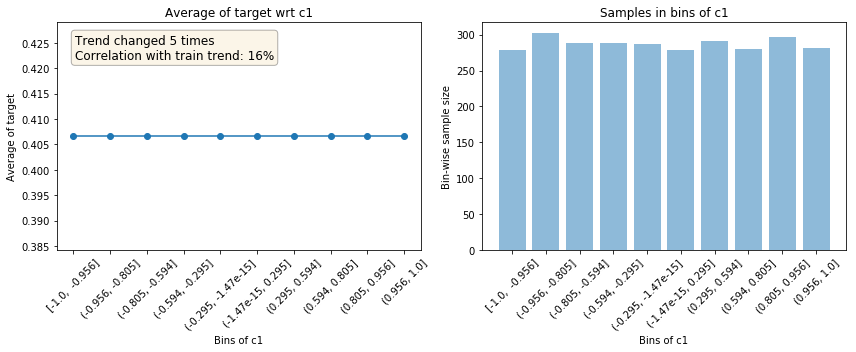

--------------------------------------------------------------------------------------------------------------


                                             Plots for s2                                             
                                           Train data plots                                           


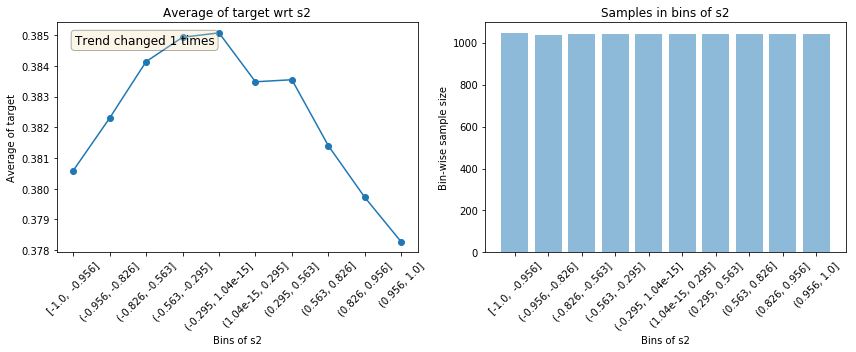

                                           Test data plots                                            


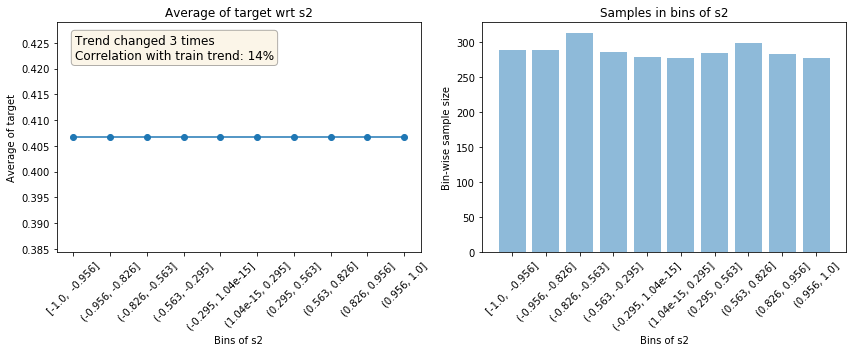

--------------------------------------------------------------------------------------------------------------


                                             Plots for c2                                             
                                           Train data plots                                           


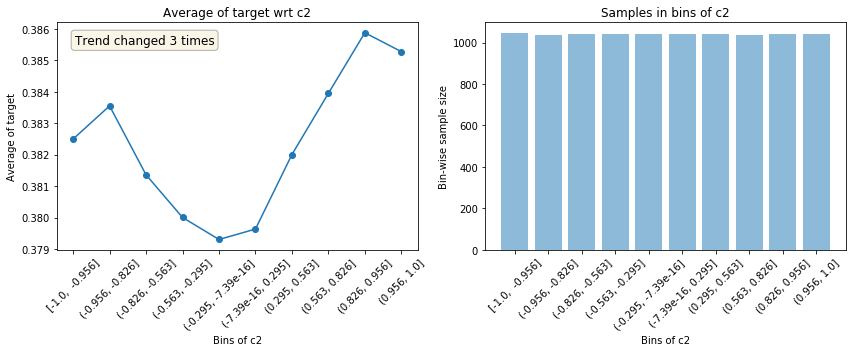

                                           Test data plots                                            


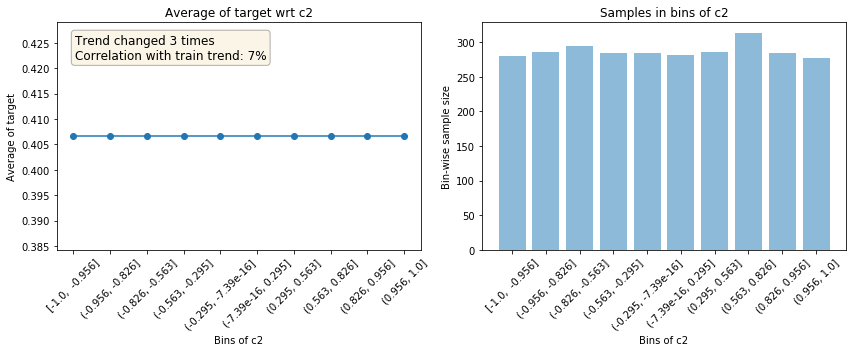

--------------------------------------------------------------------------------------------------------------


                                             Plots for s3                                             
                                           Train data plots                                           


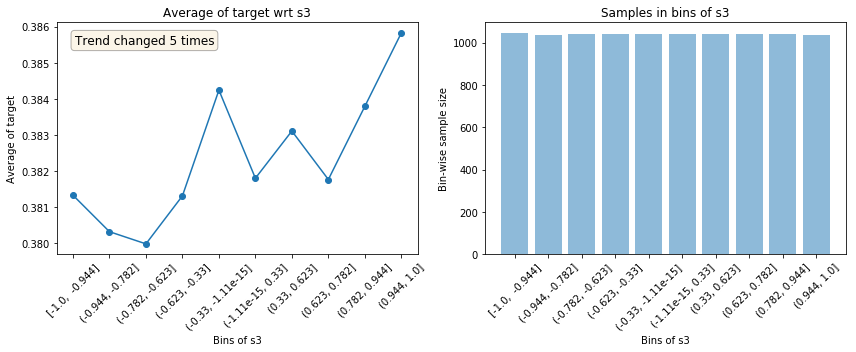

                                           Test data plots                                            


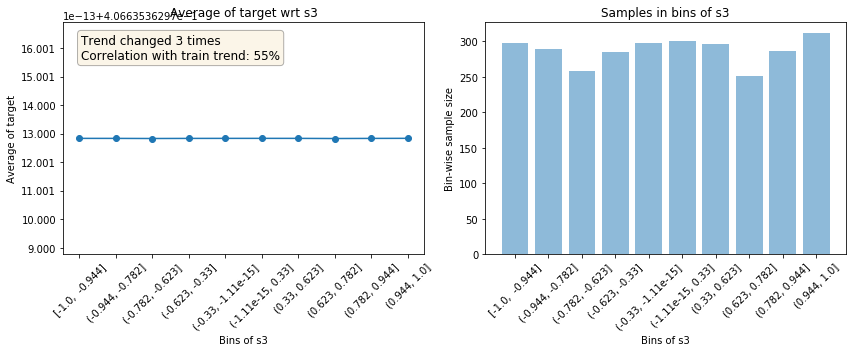

--------------------------------------------------------------------------------------------------------------


                                             Plots for c3                                             
                                           Train data plots                                           


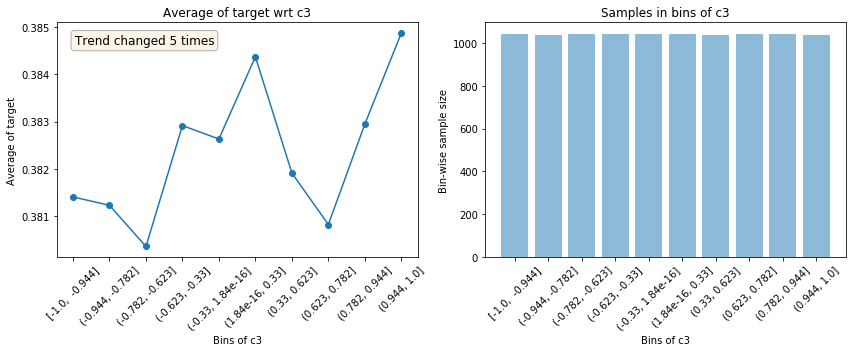

                                           Test data plots                                            


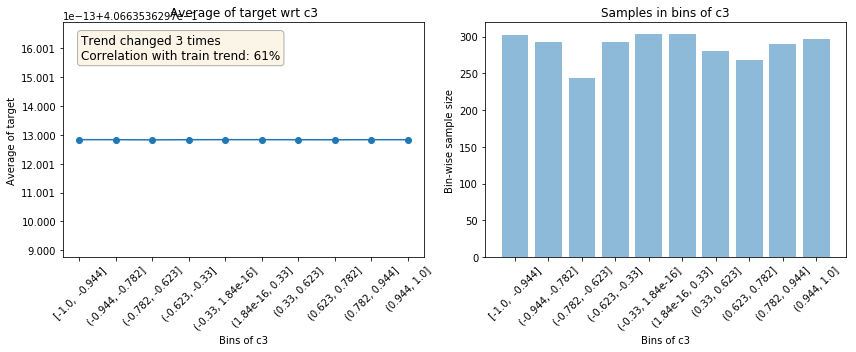

--------------------------------------------------------------------------------------------------------------


                                             Plots for s4                                             
                                           Train data plots                                           


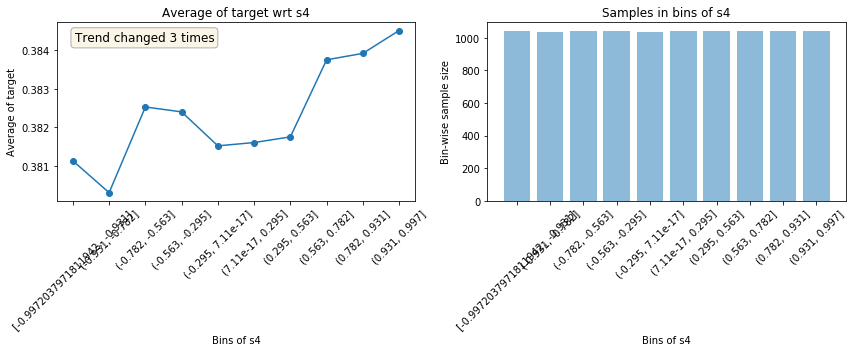

                                           Test data plots                                            


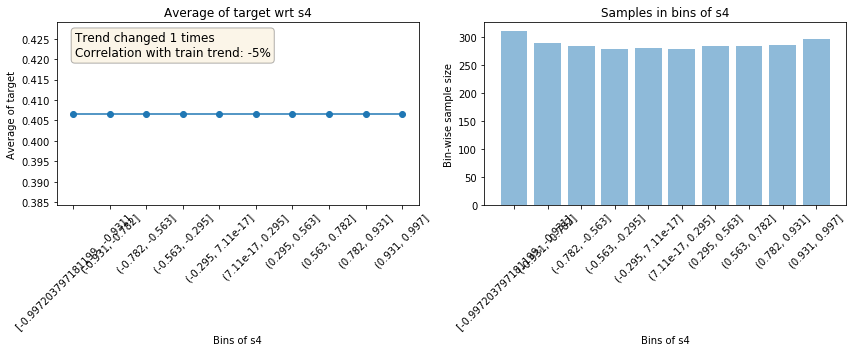

--------------------------------------------------------------------------------------------------------------


                                             Plots for c4                                             
                                           Train data plots                                           


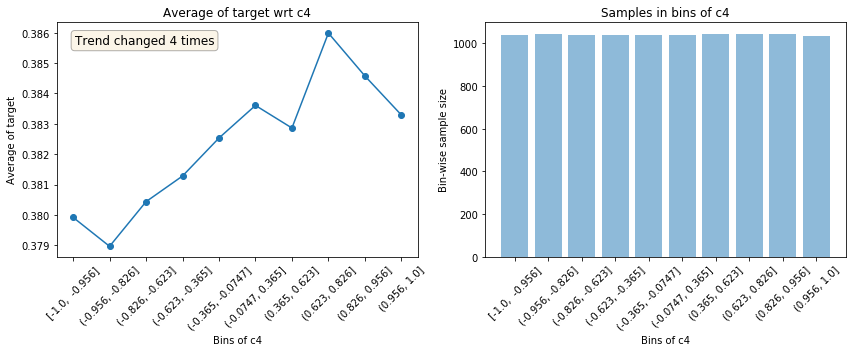

                                           Test data plots                                            


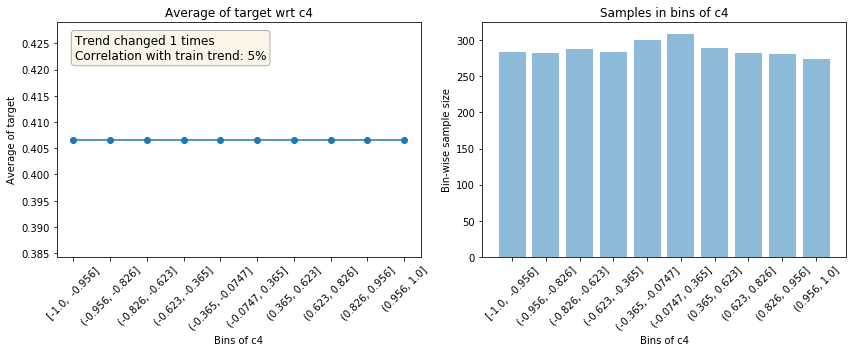

--------------------------------------------------------------------------------------------------------------


                                             Plots for s5                                             
                                           Train data plots                                           


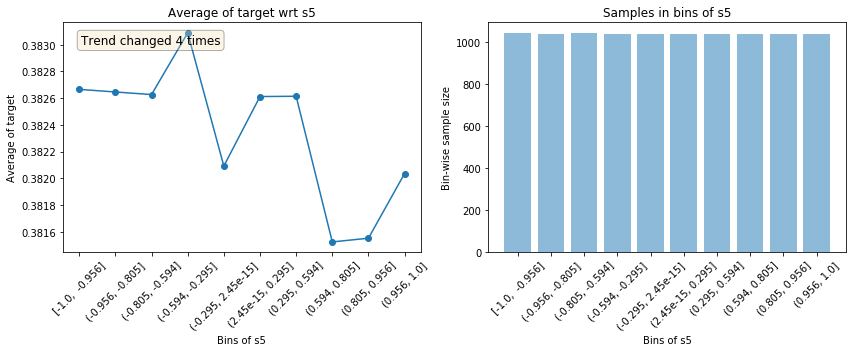

                                           Test data plots                                            


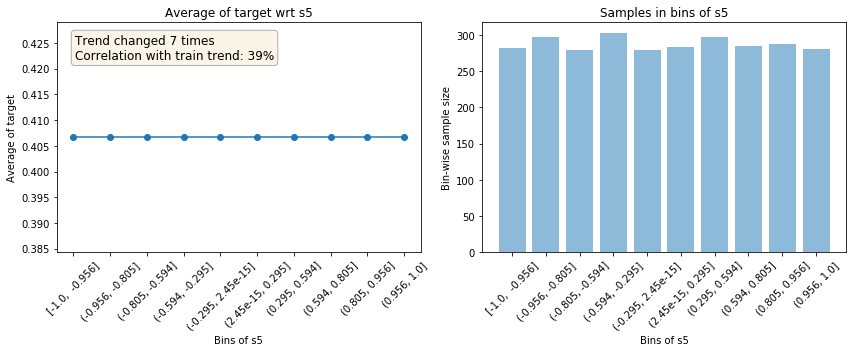

--------------------------------------------------------------------------------------------------------------


                                             Plots for c5                                             
                                           Train data plots                                           


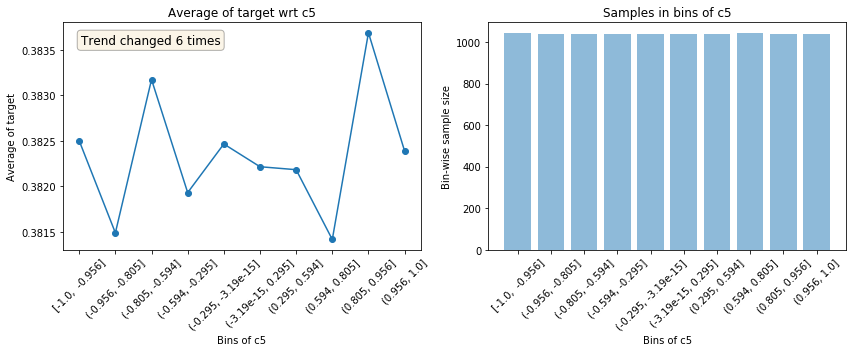

                                           Test data plots                                            


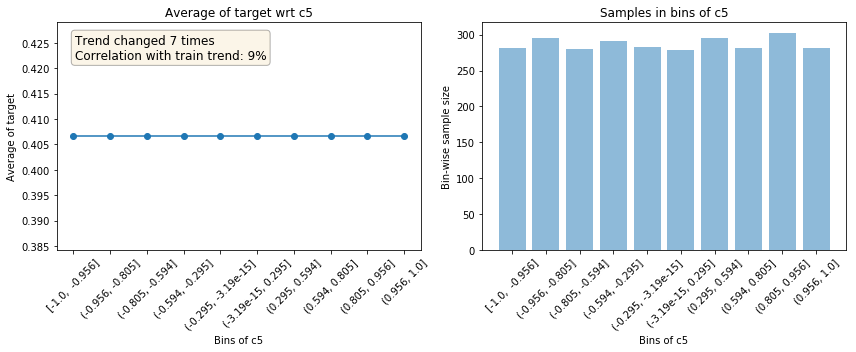

--------------------------------------------------------------------------------------------------------------


                                             Plots for s6                                             
                                           Train data plots                                           


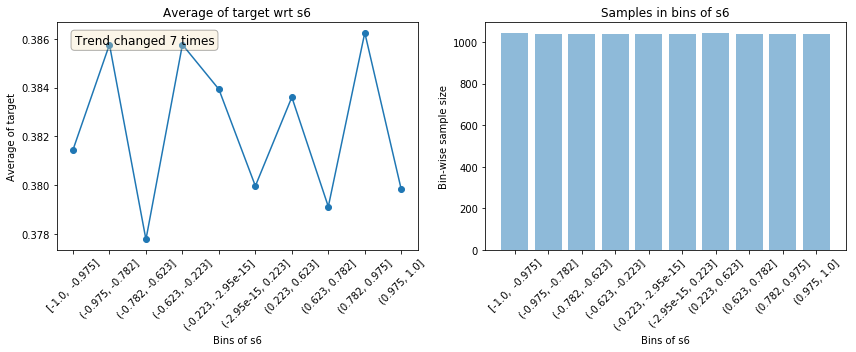

                                           Test data plots                                            


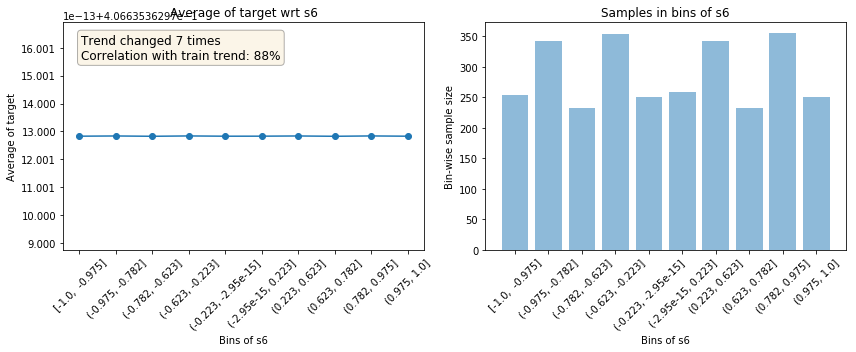

--------------------------------------------------------------------------------------------------------------


                                             Plots for c6                                             
                                           Train data plots                                           


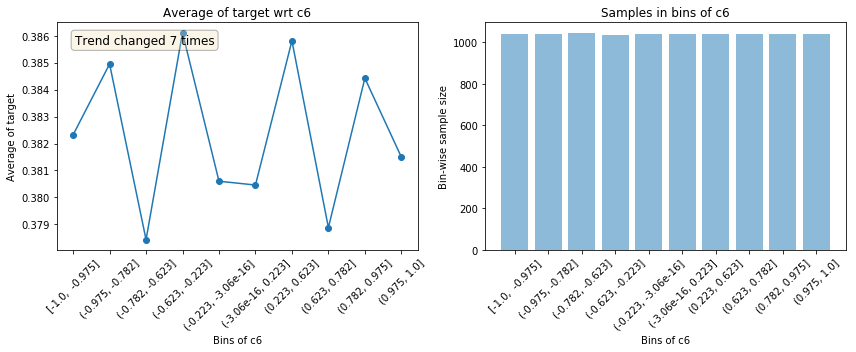

                                           Test data plots                                            


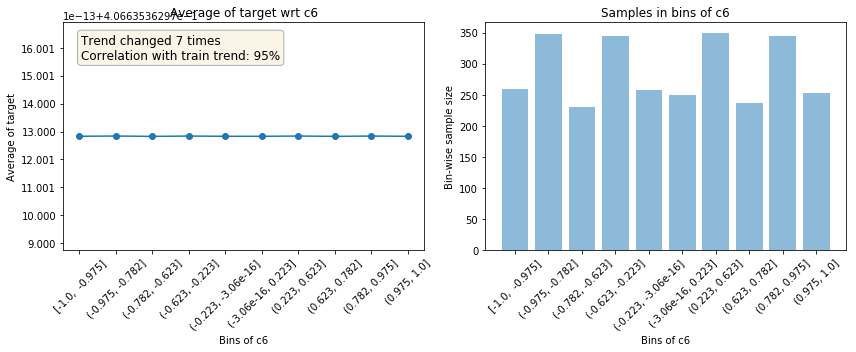

--------------------------------------------------------------------------------------------------------------


                                             Plots for s7                                             
                                           Train data plots                                           


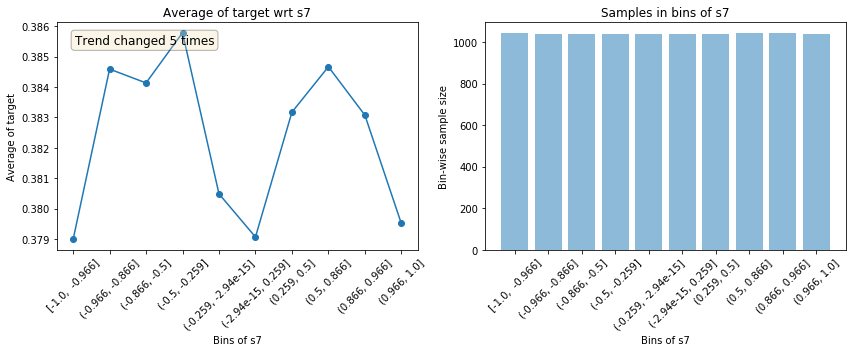

                                           Test data plots                                            


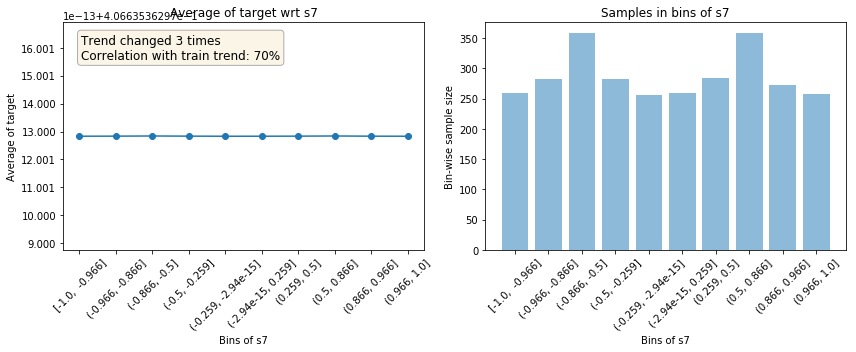

--------------------------------------------------------------------------------------------------------------


                                             Plots for c7                                             
                                           Train data plots                                           


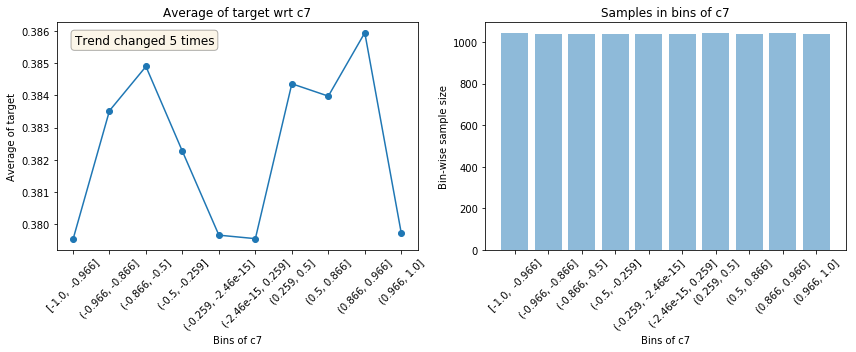

                                           Test data plots                                            


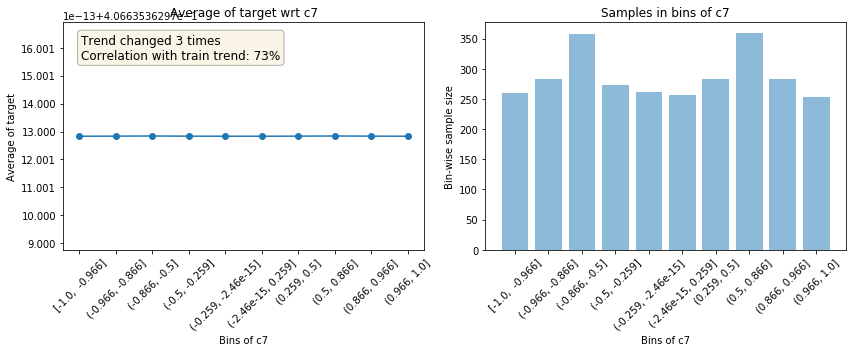

--------------------------------------------------------------------------------------------------------------


                                             Plots for s8                                             
                                           Train data plots                                           


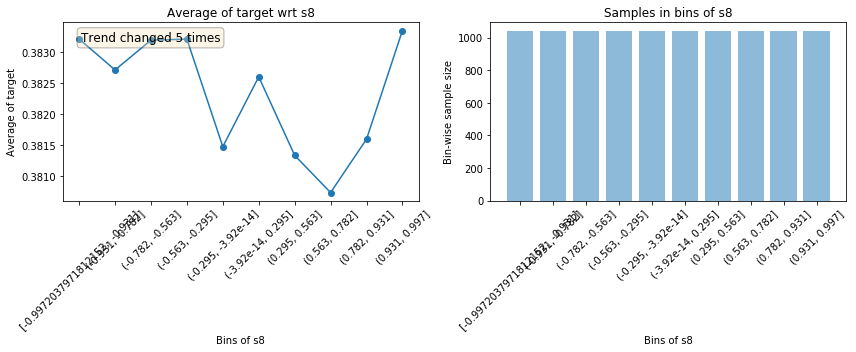

                                           Test data plots                                            


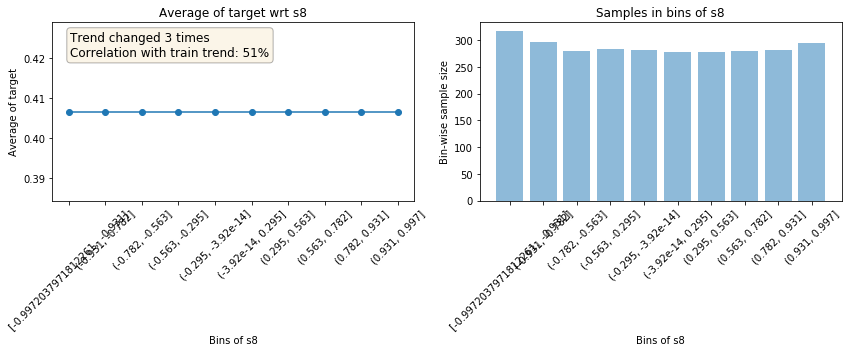

--------------------------------------------------------------------------------------------------------------


                                             Plots for c8                                             
                                           Train data plots                                           


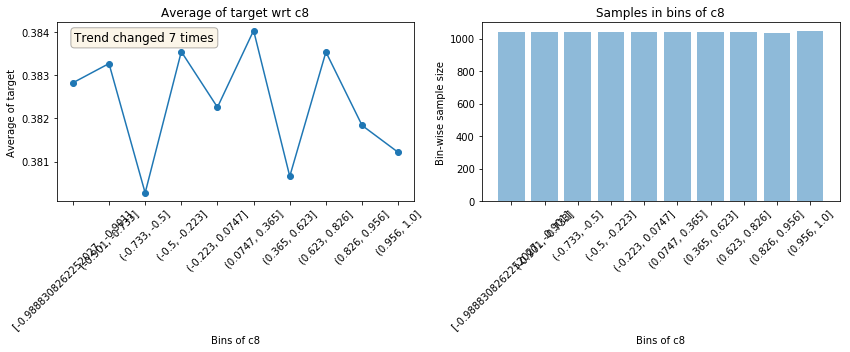

                                           Test data plots                                            


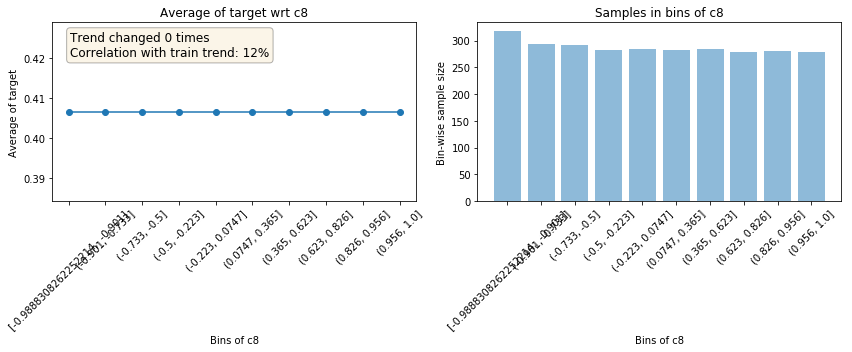

--------------------------------------------------------------------------------------------------------------


                                         Plots for fast_mean                                          
Only one bin created for fast_mean. Correlation can't be calculated
                                           Train data plots                                           


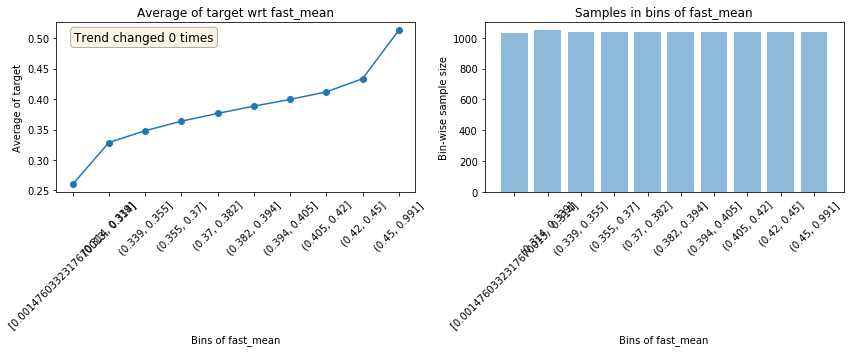

                                           Test data plots                                            


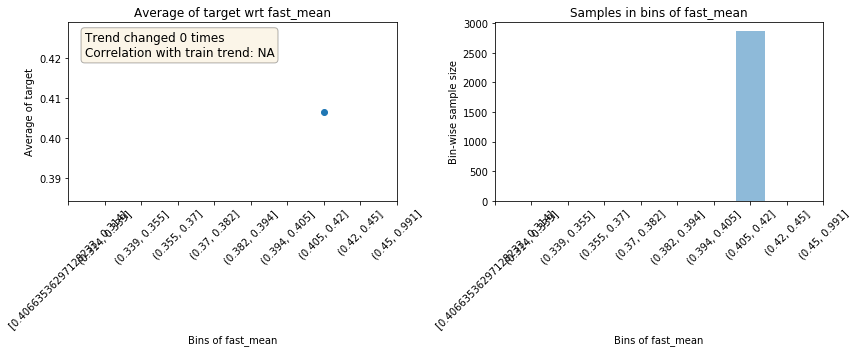

--------------------------------------------------------------------------------------------------------------


                                         Plots for slow_mean                                          
Only one bin created for slow_mean. Correlation can't be calculated
                                           Train data plots                                           


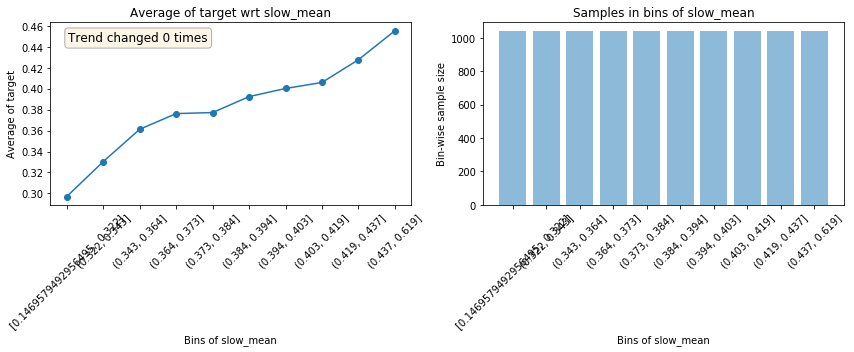

                                           Test data plots                                            


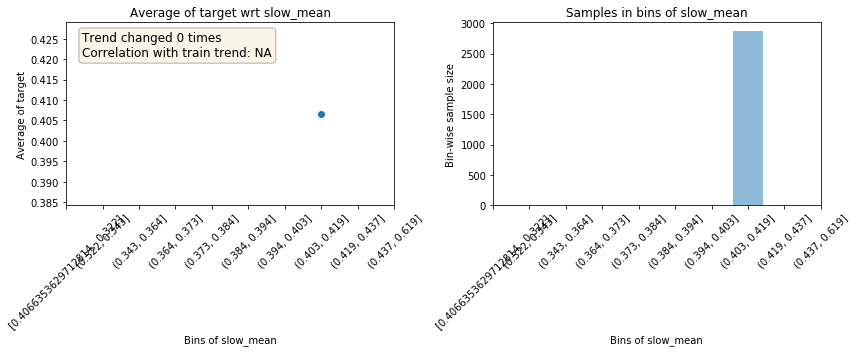

--------------------------------------------------------------------------------------------------------------


                                          Plots for outlier                                           


KeyError: 'outlier'

In [18]:
# Plots drawn for all features if nothing is passed in feature_list parameter.
if 'f_37' in X_train_fe.columns:
    X_train_fe.drop('f_37', axis=1, inplace=True)
    
get_univariate_plots(data=X_train_fe, target_col='target', data_test=X_test_fe,
                     features_list=X_train_fe.columns.tolist(), bins=10)

## removing f_37 as noisy features

In [9]:
if 'f_37' in X_train_fe.columns:
    X_train_fe.drop('f_37', axis=1, inplace=True)
    
stats = get_trend_stats(data=X_train_fe, target_col='target', data_test=X_test_fe, #.drop('f_38', axis=1),
                     features_list=X_train_fe.columns[:-1].tolist(), bins=10)
#stats

Categorical features ['target'] ignored. Categorical features not supported yet.
Returning stats for all numeric features


In [150]:
corr_features_df = calc_corr_features(stats, corr_threshold = 0.45)
corr_features = list(set(corr_features_df.index.tolist() + [])) #time_features)) # []))
features = corr_features # + ['outlier']
print(sorted(features))

Total number of features:  72
Number of highly correlated features:  32
['c3', 'c6', 'c7', 'f_12', 'f_14', 'f_17', 'f_18', 'f_19', 'f_2', 'f_20', 'f_21', 'f_22', 'f_25', 'f_26', 'f_27', 'f_30', 'f_32', 'f_34', 'f_38', 'f_39', 'f_4', 'f_40', 'f_41', 'f_45', 'f_47', 'f_5', 'f_7', 'is_weekend', 's3', 's6', 's7', 's8']


In [22]:
# merged_df[:'2017-12-01 23:00:00'], len(merged_df[:'2017-11-01 23:00:00']
corr_features_df = calc_corr_features(stats, corr_threshold = 0.45)
corr_features = list(set(corr_features_df.index.tolist() + time_features)) # []))
features = corr_features + ['outlier']
print(sorted(features))

Total number of features:  37
Number of highly correlated features:  33
['c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'day', 'f_10', 'f_11', 'f_12', 'f_14', 'f_15', 'f_17', 'f_21', 'f_22', 'f_25', 'f_26', 'f_29', 'f_32', 'f_33', 'f_34', 'f_36', 'f_38', 'f_39', 'f_4', 'f_40', 'f_44', 'f_47', 'f_8', 'f_9', 'fast_mean', 'hour', 'is_weekend', 'month', 'outlier', 's1', 's2', 's3', 's4', 's5', 's6', 's7', 's8', 'weekday']


In [164]:
import warnings
#warnings.filterwarnings('ignore')
tscv = TimeSeriesSplit(n_splits=10)
gbr = GradientBoostingRegressor()

X_train_fe, y_train_fe, X_test_fe, y_test_fe = train_test_split(merged_df[:'2017-12-01 23:00:00'], 
                                                                len(merged_df[:'2017-11-01 23:00:00']))
X_train_fe = scale_dataframe(X_train_fe, scaler.fit(X_train_fe))
y_train_fe = scale_dataframe(y_train_fe[['target']], target_scaler.fit(y_train_fe[['target']]))
X_train_fe = preprocessing(X_train_fe)
X_train_fe = anomaly_detection_std(X_train_fe, feature_names=feature_names)

X_test_fe = scale_dataframe(X_test_fe, scaler)
X_test_fe = preprocessing(X_test_fe, train_data=False)
X_test_fe = anomaly_markdown_std(X_test_fe, X_train_fe.mean(), X_train_fe.std(), feature_names=feature_names, 
                                 outliers_threshold=10)

X_train_fe = X_train_fe[features]
#X_train_fe = X_train_fe.drop('target', axis=1)
y_train_fe = y_train_fe['target']

scores=[]
full_prediction = []
for train_ind, test_ind in tscv.split(X_train_fe):
    used_indexes = len(train_ind) + len(test_ind)
    gbr.fit(X_train_fe.iloc[train_ind], y_train_fe.iloc[train_ind])
    pred = gbr.predict(X_train_fe.iloc[test_ind])
    
    # for drawing prediction
    full_prediction.append(np.concatenate([y_train_fe[train_ind].values, pred, np.zeros(len(X_train_fe) - used_indexes)]))
    
    score = MSE(y_train_fe[test_ind], pred)**0.5
    scores.append(score)
    print('train len: ', len(train_ind), '\t till ', X_train_fe.index[train_ind[-1]]  ,'\t score: ' , score)

print('average score: ', np.mean(scores))

train len:  820 	 till  2016-11-27 19:00:00 	 score:  0.027851214955690675
train len:  1634 	 till  2016-12-31 17:00:00 	 score:  0.01601246983753226
train len:  2448 	 till  2017-02-03 15:00:00 	 score:  0.04991226419032063
train len:  3262 	 till  2017-03-09 13:00:00 	 score:  0.013400051766186132
train len:  4076 	 till  2017-04-12 11:00:00 	 score:  0.026329376592941107
train len:  4890 	 till  2017-05-16 09:00:00 	 score:  0.010726647253718222
train len:  5704 	 till  2017-06-19 07:00:00 	 score:  0.01099299522007129
train len:  6518 	 till  2017-07-23 05:00:00 	 score:  0.010544820404592817
train len:  7332 	 till  2017-08-26 03:00:00 	 score:  0.0603407908474137
train len:  8146 	 till  2017-09-29 01:00:00 	 score:  0.012363096222505027
average score:  0.023847372729097187


In [165]:
# training step
pred_df = pd.DataFrame(full_prediction[8], index=X_train_fe.index)
print(pred_df.mean())
pred_df = restore_dataframe(pred_df, target_scaler)

quality_metric(merged_df.loc[pred_df.index].target, pred_df)
pred_df.hvplot() * merged_df.target.hvplot() * X_train_fe.outlier.hvplot()

0    0.342335
dtype: float64
prediction rmse 0.7804222358869103
simple mean() rmse 0.888290201691545


:Overlay
   .Curve.I       :Curve   [timestamp]   (0)
   .Curve.Target  :Curve   [timestamp]   (target)
   .Curve.Outlier :Curve   [timestamp]   (outlier)

In [166]:
# validation step!
X_val_raw = merged_df['2017-12-01 23:00:00':'2018-01-01 00:00:00'].drop(targets[1:], axis=1)
y_val = merged_df['2017-12-01 23:00:00':'2018-01-01 00:00:00'][['target']]

X_val = scale_dataframe(X_val_raw, scaler)
X_val = preprocessing(X_val, train_data=False)
X_val = anomaly_markdown_std(X_val, X_train.mean(), X_train.std(), 
                             feature_names=feature_names, outliers_threshold=10)
X_val = X_val[features]

val_pred = gbr.predict(X_val)

pred_df = pd.DataFrame(val_pred, index=X_val_raw.index, columns=['prediction'])
pred_df = restore_dataframe(pred_df, target_scaler)
quality_metric(merged_df.loc[pred_df.index].target, pred_df.prediction)

pred_df.hvplot() * merged_df.target.hvplot() * X_val.outlier.hvplot()

prediction rmse 0.0818192991189532
simple mean() rmse 0.24848031448034694


:Overlay
   .Curve.I       :Curve   [timestamp]   (prediction)
   .Curve.Target  :Curve   [timestamp]   (target)
   .Curve.Outlier :Curve   [timestamp]   (outlier)

In [168]:
# prediction
X_pred_raw = merged_df['2018-01-01 00:00:00':].drop(targets[1:], axis=1)

X_pred = scale_dataframe(X_pred_raw, scaler)
X_pred = preprocessing(X_pred, train_data=False)
X_pred = anomaly_markdown_std(X_pred, X_train.mean(), X_train.std(), 
                             feature_names=features[:-1], outliers_threshold=10)
X_pred = X_pred[features]

pred = gbr.predict(X_pred)

pred_df = pd.DataFrame(pred, index=X_pred_raw.index, columns=['prediction'])
pred_df = restore_dataframe(pred_df, target_scaler)

#save_prediction(pred_df.values, index=pred_df.index, filename='grad_boost_fe.csv')

# 0.4701 - 13 place
# my score is:  0.02370241580489297  ->  0.09581709090748912

In [169]:
pred_df.hvplot() * merged_df.target.hvplot() * X_pred.outlier.hvplot()

:Overlay
   .Curve.I       :Curve   [timestamp]   (prediction)
   .Curve.Target  :Curve   [timestamp]   (target)
   .Curve.Outlier :Curve   [timestamp]   (outlier)

## XGBoost

In [46]:
print(features)

['c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'day', 'f_10', 'f_11', 'f_12', 'f_14', 'f_15', 'f_17', 'f_21', 'f_22', 'f_25', 'f_26', 'f_29', 'f_32', 'f_33', 'f_34', 'f_36', 'f_38', 'f_39', 'f_4', 'f_40', 'f_44', 'f_47', 'f_8', 'f_9', 'fast_mean', 'hour', 'is_weekend', 'month', 's1', 's2', 's3', 's4', 's5', 's6', 's7', 's8', 'weekday', 'outlier']


In [47]:
from xgboost import XGBRegressor
xgbr = XGBRegressor()

X_train_fe, y_train_fe, X_test_fe, y_test_fe = train_test_split(merged_df[:'2017-12-01 23:00:00'], 
                                                                len(merged_df[:'2017-11-01 23:00:00']))
X_train_fe = scale_dataframe(X_train_fe, scaler.fit(X_train_fe))
y_train_fe = scale_dataframe(y_train_fe[['target']], target_scaler.fit(y_train_fe[['target']]))
X_train_fe = preprocessing(X_train_fe)
X_train_fe = anomaly_detection_std(X_train_fe, feature_names=feature_names)

X_test_fe = scale_dataframe(X_test_fe, scaler)
X_test_fe = preprocessing(X_test_fe, train_data=False)

# finding correlated with target features
if 'f_37' in X_train_fe.columns:
    X_train_fe.drop('f_37', axis=1, inplace=True)
stats = get_trend_stats(data=X_train_fe, target_col='target', data_test=X_test_fe,
                     features_list=X_train_fe.columns[:-1].tolist(), bins=10)

corr_features = calc_corr_features(stats)
features = corr_features.index.tolist() + ['outlier']

X_train_fe = X_train_fe[features].copy()
y_train_fe = y_train_fe['target']

scores=[]
full_prediction = []
for train_ind, test_ind in tscv.split(X_train_fe):
    used_indexes = len(train_ind) + len(test_ind)
    xgbr.fit(X_train_fe.iloc[train_ind], y_train_fe[train_ind])
    pred = xgbr.predict(X_train_fe.iloc[test_ind])
    
    # for drawing prediction
    full_prediction.append(np.concatenate([y_train_fe[train_ind].values, pred, np.zeros(len(X_train_fe) - used_indexes)]))
    
    score = MSE(y_train_fe[test_ind], pred)**0.5
    scores.append(score)
    print('train len: ', len(train_ind), '\t till ', X_train_fe.index[train_ind[-1]]  ,'\t score: ' , score)

print('average score: ', np.mean(scores))

Categorical features ['target'] ignored. Categorical features not supported yet.
Returning stats for all numeric features
Total number of features:  72
Number of highly correlated features:  34
train len:  820 	 till  2016-11-27 19:00:00 	 score:  0.028270193944723847
train len:  1634 	 till  2016-12-31 17:00:00 	 score:  0.017351546844626628
train len:  2448 	 till  2017-02-03 15:00:00 	 score:  0.0497561719329165
train len:  3262 	 till  2017-03-09 13:00:00 	 score:  0.012442780386930847
train len:  4076 	 till  2017-04-12 11:00:00 	 score:  0.032540523615352895
train len:  4890 	 till  2017-05-16 09:00:00 	 score:  0.010798468650715537
train len:  5704 	 till  2017-06-19 07:00:00 	 score:  0.010522415494146283
train len:  6518 	 till  2017-07-23 05:00:00 	 score:  0.010487212007953784
train len:  7332 	 till  2017-08-26 03:00:00 	 score:  0.06235967524427558
train len:  8146 	 till  2017-09-29 01:00:00 	 score:  0.011107589085784266
average score:  0.024563657720742614


In [182]:
# training step
pred_df = pd.DataFrame(full_prediction[7], index=X_train_fe.index)
print(pred_df.mean())
pred_df = restore_dataframe(pred_df, target_scaler)

quality_metric(merged_df.loc[pred_df.index].target, pred_df)
pred_df.hvplot() * merged_df.target.hvplot() * X_train_fe.outlier.hvplot()

0    0.305309
dtype: float64
prediction rmse 1.1865262532512213
simple mean() rmse 1.1441421340184452


:Overlay
   .Curve.I       :Curve   [timestamp]   (0)
   .Curve.Target  :Curve   [timestamp]   (target)
   .Curve.Outlier :Curve   [timestamp]   (outlier)

In [181]:
# validation step!
X_val_raw = merged_df['2017-12-01 23:00:00':'2018-01-01 00:00:00'].drop(targets[1:], axis=1)
y_val = merged_df['2017-12-01 23:00:00':'2018-01-01 00:00:00'][['target']]

X_val = scale_dataframe(X_val_raw, scaler)
X_val = preprocessing(X_val, train_data=False)
X_val = anomaly_markdown_std(X_val, X_train.mean(), X_train.std(), 
                             feature_names=feature_names, outliers_threshold=10)
X_val = X_val[features]

val_pred = xgbr.predict(X_val)

pred_df = pd.DataFrame(val_pred, index=X_val_raw.index, columns=['prediction'])
pred_df = restore_dataframe(pred_df, target_scaler)
quality_metric(merged_df.loc[pred_df.index].target, pred_df.prediction)

pred_df.hvplot() * merged_df.target.hvplot() * X_val.outlier.hvplot()

prediction rmse 0.07951701202990978
simple mean() rmse 0.23784190609644792


:Overlay
   .Curve.I       :Curve   [timestamp]   (prediction)
   .Curve.Target  :Curve   [timestamp]   (target)
   .Curve.Outlier :Curve   [timestamp]   (outlier)

In [185]:
# prediction
X_pred_raw = merged_df['2018-01-01 00:00:00':].drop(targets[1:], axis=1)

X_pred = scale_dataframe(X_pred_raw, scaler)
X_pred = preprocessing(X_pred, train_data=False)
X_pred = anomaly_markdown_std(X_pred, X_train.mean(), X_train.std(), 
                             feature_names=features[:-1], outliers_threshold=10)
X_pred = X_pred[features]

pred = xgbr.predict(X_pred)

pred_df = pd.DataFrame(pred, index=X_pred_raw.index, columns=['prediction'])
pred_df = restore_dataframe(pred_df, target_scaler)

#save_prediction(pred_df.values, index=pred_df.index, filename='grad_boost_fe.csv')
pred_df.hvplot() * merged_df.target.hvplot() * X_pred.outlier.hvplot()

# 0.4701 - 13 place
# my score is:  0.02370241580489297  ->  0.09581709090748912

:Overlay
   .Curve.I       :Curve   [timestamp]   (prediction)
   .Curve.Target  :Curve   [timestamp]   (target)
   .Curve.Outlier :Curve   [timestamp]   (outlier)

## Step by step prediction

In [48]:
X_pred_raw = merged_df['2018-01-01 00:00:00':].drop(targets[1:], axis=1)
'''
features = ['c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'day', 'f_10', 'f_11', 'f_12', 'f_14', 'f_15', 'f_17', 
            'f_21', 'f_22', 'f_25', 'f_26', 'f_29', 'f_32', 'f_33', 'f_34', 'f_36', 'f_38', 'f_39', 'f_4', 'f_40', 
            'f_44', 'f_47', 'f_8', 'f_9', 'fast_mean', 'hour', 'is_weekend', 'month', 's1', 's2', 's3', 's4', 's5', 
            's6', 's7', 's8', 'weekday', 'outlier']
'''
X_train, y_train, X_test, y_test = train_test_split(merged_df[:'2017-12-01 23:00:00'], len(merged_df[:'2017-11-01 23:00:00']))
X_train = scale_dataframe(X_train, scaler.fit(X_train))
y_train = scale_dataframe(y_train[['target']], target_scaler.fit(y_train[['target']]))
X_train = preprocessing(X_train)

X_pred = scale_dataframe(X_pred_raw, scaler)
X_pred = preprocessing(X_pred, train_data=False)

X_pred = anomaly_markdown_std(X_pred, X_train.mean(), X_train.std(), 
                             outliers_threshold=10)

if 'f_37' in X_pred.columns:
    X_pred.drop('f_37', axis=1, inplace=True)
    
X_pred = X_pred[features]

Index(['f_0', 'f_1', 'f_2', 'f_3', 'f_4', 'f_5', 'f_6', 'f_7', 'f_8', 'f_9',
       'f_10', 'f_11', 'f_12', 'f_13', 'f_14', 'f_15', 'f_16', 'f_17', 'f_18',
       'f_19', 'f_20', 'f_21', 'f_22', 'f_23', 'f_24', 'f_25', 'f_26', 'f_27',
       'f_28', 'f_29', 'f_30', 'f_31', 'f_32', 'f_33', 'f_34', 'f_35', 'f_36',
       'f_37', 'f_38', 'f_39', 'f_40', 'f_41', 'f_42', 'f_43', 'f_44', 'f_45',
       'f_46', 'f_47', 'target', 'hour', 'day', 'weekday', 'month',
       'is_weekend', 's1', 'c1', 's2', 'c2', 's3', 'c3', 's4', 'c4', 's5',
       'c5', 's6', 'c6', 's7', 'c7', 's8', 'c8', 'fast_mean', 'slow_mean'],
      dtype='object')


In [49]:
pred = xgbr.predict(X_pred)

pred_df = pd.DataFrame(pred, index=X_pred_raw.index, columns=['prediction'])
pred_df = restore_dataframe(pred_df, target_scaler)

#save_prediction(pred_df.values, index=pred_df.index, filename='grad_xgboost_fe.csv')
pred_df.hvplot() * merged_df.target.hvplot() * X_pred.outlier.hvplot()

:Overlay
   .Curve.I       :Curve   [timestamp]   (prediction)
   .Curve.Target  :Curve   [timestamp]   (target)
   .Curve.Outlier :Curve   [timestamp]   (outlier)